<a href="https://colab.research.google.com/github/Y23-DS/AI-in-healthcare-HW/blob/main/YS_MIMIC_III_NLP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!python -m spacy download en_core_web_sm
!pip install https://s3-us-west-2.amazonaws.com/ai2-s2-scispacy/releases/v0.4.0/en_core_sci_md-0.4.0.tar.gz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.8/12.8 MB 40.8 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.
  Using cached https://s3-us-west-2.amazonaws.com/ai2-s2-scispacy/releases/v0.4.0/en_core_sci_md-0.4.0.tar.gz (125.2 MB)
  Preparing metadata (setup.py) ... done
  Using cached spacy-3.0.9-cp311-cp311-linux_x86_64.whl
  Using cached thinc-8.0.17-cp311-cp311-linux_x86_64.whl
  Using cached pydantic-1.8.2-py3-none-any.whl.metadata (103 kB)
Using cached pydantic-1.8.2-py3-none-any.whl (126 kB)
  Attempting uninstall: pydantic
    Found existing installation: pydantic 1.10.13
    Uninstalling pydantic-1.10.13:
      Successfully uninstalled pydantic-1.10.13
  Attempting uninstall:

In [2]:
# Uninstall current versions
!pip uninstall pydantic spacy

# Install compatible versions
!pip install pydantic==1.10.13
!pip install spacy
!pip install scispacy

Found existing installation: pydantic 1.8.2
Uninstalling pydantic-1.8.2:
  Would remove:
    /usr/local/lib/python3.11/dist-packages/pydantic-1.8.2.dist-info/*
    /usr/local/lib/python3.11/dist-packages/pydantic/*
Proceed (Y/n)? y
  Successfully uninstalled pydantic-1.8.2
Found existing installation: spacy 3.0.9
Uninstalling spacy-3.0.9:
  Would remove:
    /usr/local/bin/spacy
    /usr/local/lib/python3.11/dist-packages/spacy-3.0.9.dist-info/*
    /usr/local/lib/python3.11/dist-packages/spacy/*
Proceed (Y/n)? y
  Successfully uninstalled spacy-3.0.9
  Using cached pydantic-1.10.13-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (149 kB)
Using cached pydantic-1.10.13-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (3.1 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
thinc 8.0.17 requires pydantic!=1.8,!=1.8.1,<1.9.0,>=1.7.4, 

In [1]:
import spacy
import en_core_sci_md

nlp_spacy = spacy.load("en_core_web_sm")
nlp_scispacy = en_core_sci_md.load()

print("succeed to load Spacy and SciSpacy")

/usr/local/lib/python3.11/dist-packages/spacy/util.py:910: UserWarning: [W095] Model 'en_core_sci_md' (0.4.0) was trained with spaCy v3.0.1 and may not be 100% compatible with the current version (3.7.5). If you see errors or degraded performance, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)


succeed to load Spacy and SciSpacy


In [2]:
import scispacy
import en_core_sci_md

nlp = en_core_sci_md.load()

In [5]:
!pip install medspacy

In [1]:
import pandas as pd
import numpy as np
import string
import gzip
import re
import torch
import spacy
import scispacy
import medspacy
import en_core_sci_md
from collections import Counter
from wordcloud import WordCloud
from gensim.models import Word2Vec
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from transformers import AutoModel, AutoTokenizer, BertTokenizer

In [4]:
# Read the uploaded file
file_path = 'NOTEEVENTS.csv.gz'
diagnoses_icd_df = pd.read_csv(file_path, compression='gzip')

In [5]:
# Display basic info and the first row
diagnoses_icd_df.info()
print("First row of the dataset:")
print(diagnoses_icd_df.iloc[0])
print("\nTotal number of records:", len(diagnoses_icd_df))
display(diagnoses_icd_df.head())



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2083180 entries, 0 to 2083179
Data columns (total 11 columns):
 #   Column       Dtype  
---  ------       -----  
 0   ROW_ID       int64  
 1   SUBJECT_ID   int64  
 2   HADM_ID      float64
 3   CHARTDATE    object 
 4   CHARTTIME    object 
 5   STORETIME    object 
 6   CATEGORY     object 
 7   DESCRIPTION  object 
 8   CGID         float64
 9   ISERROR      float64
 10  TEXT         object 
dtypes: float64(3), int64(2), object(6)
memory usage: 174.8+ MB
First row of the dataset:
ROW_ID                                                       174
SUBJECT_ID                                                 22532
HADM_ID                                                 167853.0
CHARTDATE                                             2151-08-04
CHARTTIME                                                    NaN
STORETIME                                                    NaN
CATEGORY                                       Discharge summary
DESC

,ROW_ID,SUBJECT_ID,HADM_ID,CHARTDATE,CHARTTIME,STORETIME,CATEGORY,DESCRIPTION,CGID,ISERROR,TEXT
0,174,22532,167853.0,2151-08-04,NaN,NaN,Discharge summary,Report,NaN,NaN,Admission Date: [**2151-7-16**] Dischar...
1,175,13702,107527.0,2118-06-14,NaN,NaN,Discharge summary,Report,NaN,NaN,Admission Date: [**2118-6-2**] Discharg...
2,176,13702,167118.0,2119-05-25,NaN,NaN,Discharge summary,Report,NaN,NaN,Admission Date: [**2119-5-4**] D...
3,177,13702,196489.0,2124-08-18,NaN,NaN,Discharge summary,Report,NaN,NaN,Admission Date: [**2124-7-21**] ...
4,178,26880,135453.0,2162-03-25,NaN,NaN,Discharge summary,Report,NaN,NaN,Admission Date: [**2162-3-3**] D...


In [6]:
# Filter the dataset based on an ICD9 code ('995')
arr_subject_id = []
arr_hadm_id = []
for row in range(len(diagnoses_icd_df)):
    if 'ICD9_CODE' in diagnoses_icd_df.columns and diagnoses_icd_df.loc[row, 'ICD9_CODE'] == '995':
        arr_subject_id.append(diagnoses_icd_df.loc[row, 'SUBJECT_ID'])
print("Number of records with ICD9 code '995':", len(arr_subject_id))


if 'TEXT' in diagnoses_icd_df.columns:
    notes = diagnoses_icd_df['TEXT'].dropna().tolist()[:50]
    print("\nExtracted {} note texts for processing.".format(len(notes)))
else:
    raise ValueError("The dataset does not contain a 'TEXT' column with the note content.")



Number of records with ICD9 code '995': 0

Extracted 50 note texts for processing.


In [9]:
# Entity Extraction with Spacy
from spacy import displacy


nlp_spacy = spacy.load('en_core_web_sm')

spacy_entities = []

print("\n---- Spacy Entity Extraction ----")
for i, note in enumerate(notes):
    doc = nlp_spacy(note)
    note_entities = [(ent.text, ent.label_) for ent in doc.ents]
    spacy_entities.append(note_entities)
    print("Note {}:".format(i+1), note_entities)
    # Visualize
    displacy.render(doc, style="ent", jupyter=True)
    print("-" * 80)


---- Spacy Entity Extraction ----
Note 1: [('2151-7-16', 'DATE'), ('2151-8-4', 'DATE'), ('Radiologic', 'PERSON'), ('CT', 'ORG'), ('Abdominal CT', 'ORG'), ('T10', 'ORG'), ('First', 'ORDINAL'), ('First Name4', 'ORG'), ('1775', 'DATE'), ('M.D.', 'GPE'), ('MD', 'GPE'), ('1776', 'DATE'), ('1807', 'DATE'), ('2151-8-5', 'DATE'), ('2151-8-5', 'DATE'), ('Number 1808', 'DATE')]


--------------------------------------------------------------------------------
Note 2: [('2118-6-2', 'CARDINAL'), ('2118-6', 'CARDINAL'), ('Date of Birth:                    Sex:  F\n\nService:', 'WORK_OF_ART'), ('MICU', 'ORG'), ('81-year-old', 'DATE'), ('emphysema', 'PERSON'), ('O2', 'CARDINAL'), ('three days', 'DATE'), ('Two days', 'DATE'), ('90%', 'PERCENT'), ('18', 'CARDINAL'), ('100%', 'PERCENT'), ('CPAP', 'ORG'), ('Solu-Medrol', 'ORG'), ('night', 'TIME'), ('1', 'CARDINAL'), ('2117-11-3', 'DATE'), ('52%', 'PERCENT'), ('54%', 'PERCENT'), ('23%', 'PERCENT'), ('67%', 'PERCENT'), ('FVC', 'ORG'), ('2', 'CARDINAL'), ('Lacunar CVA', 'ORG'), ('2114-11-4', 'DATE'), ('T2', 'CARDINAL'), ('3', 'CARDINAL'), ('2118-1-3', 'DATE'), ('four minutes', 'TIME'), ('10,000', 'CARDINAL'), ('64%', 'PERCENT'), ('EKG', 'ORG'), ('84%', 'PERCENT'), ('sublingual nitroglycerin', 'PERSON'), ('4', 'CARDINAL'), ('Synthroid', 'PERSON'), ('5', 'CARDINAL'), ('6', 'CARDINAL'), ('approximately 10\nyears ago', 'DATE')

--------------------------------------------------------------------------------
Note 3: [('2119-5-4', 'DATE'), ('2119-5-25', 'DATE'), ('Amlodipine', 'NORP'), ('Attending:[**Last Name', 'WORK_OF_ART'), ('1561', 'DATE'), ('81', 'CARDINAL'), ('F smoker', 'PRODUCT'), ('TBM', 'ORG'), ('5', 'CARDINAL'), ('5', 'CARDINAL'), ('3/31,4/2,3,[**6-12', 'CARDINAL'), ('5-17', 'CARDINAL'), ('5-19', 'CARDINAL'), ('5', 'CARDINAL'), ('5', 'CARDINAL'), ('5-25', 'CARDINAL'), ('6', 'CARDINAL'), ('History of Present Illness', 'WORK_OF_ART'), ('81 year old', 'DATE'), ('the past five\n\nyears', 'DATE'), ('2118-6-4', 'DATE'), ('18', 'CARDINAL'), ('2118-6-9', 'CARDINAL'), ('two', 'CARDINAL'), ('one', 'CARDINAL'), ('2118-8-1', 'DATE'), ('First Name4', 'ORG'), ('951', 'CARDINAL'), ('952', 'CARDINAL'), ('2119-4-19', 'DATE'), ('about three', 'CARDINAL'), ('three', 'CARDINAL'), ('1.5-2', 'CARDINAL'), ('6', 'CARDINAL'), ('Left Main', 'FAC'), ('2118-6-9', 'CARDINAL'), ('2119-4-19', 'DATE'), ('30%', 'PERCENT'), ('RCA', 

--------------------------------------------------------------------------------
Note 4: [('2124-7-21', 'DATE'), ('2124-8-18', 'DATE'), ('Amlodipine', 'NORP'), ('898', 'CARDINAL'), ('87 yo', 'QUANTITY'), ('F', 'PRODUCT'), ('CHF', 'ORG'), ('5', 'CARDINAL'), ('tracheobronchomalacia s/p stent', 'PERSON'), ('several days', 'DATE'), ('This morning', 'TIME'), ('EMS', 'ORG'), ('EMS', 'ORG'), ('90%', 'PERCENT'), ('ER', 'ORG'), ('PND', 'ORG'), ('this morning', 'TIME'), ('96%', 'PERCENT'), ('NRB', 'ORG'), ('CXR', 'ORG'), ('EKG', 'ORG'), ('14', 'CARDINAL'), ('2.2', 'CARDINAL'), ('125', 'CARDINAL'), ('325 mg', 'QUANTITY'), ('2', 'CARDINAL'), ('500 mg\nIVx1', 'QUANTITY'), ('750', 'CARDINAL'), ('80', 'CARDINAL'), ('NRB', 'ORG'), ('about 2\nhours', 'TIME'), ('87%', 'PERCENT'), ('40s', 'DATE'), ('ABG', 'ORG'), ('7.3/60/88/31', 'DATE'), ('Propafol', 'PERSON'), ('80s', 'DATE'), ('NS', 'GPE'), ('VS', 'PRODUCT'), ('102', 'CARDINAL'), ('100%', 'PERCENT'), ('60%', 'PERCENT'), ('450', 'CARDINAL'), ('18', 'CA

--------------------------------------------------------------------------------
Note 5: [('2162-3-3', 'DATE'), ('2162-3-25', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2080-1-4', 'DATE'), ('No Known Allergies to Drugs', 'ORG'), ('1829', 'DATE'), ('18', 'CARDINAL'), ('10 feet', 'QUANTITY'), ('CT', 'ORG'), ('C6-7 &', 'ORG'), ('1', 'CARDINAL'), ('C6-C7', 'PRODUCT'), ('2', 'CARDINAL'), ('3', 'CARDINAL'), ('4', 'CARDINAL'), ('C5-C6-C7', 'PRODUCT'), ('5', 'CARDINAL'), ('C5-C6-C7', 'PRODUCT'), ('6', 'CARDINAL'), ('C6-C7', 'PRODUCT'), ('T1', 'GPE'), ('7', 'CARDINAL'), ('C4-T1', 'PRODUCT'), ('8', 'CARDINAL'), ('C4-T1', 'PERSON'), ('9', 'CARDINAL'), ('1829', 'DATE'), ('82 year old', 'DATE'), ('approximately 10 feet', 'QUANTITY'), ('18', 'CARDINAL'), ('CT', 'ORG'), ('Coronary', 'ORG'), ('Atrial', 'ORG'), ('Stroke\n\nSocial History:\nPatient', 'ORG'), ('Family History', 'PERSON'), ('Physical Exam:\n', 'WORK_OF_ART'), ('TSICU', 'ORG'), ('NAD', 'ORG'), ('97.5', 'CARDINAL'), ('61', 'CARDINAL'),

--------------------------------------------------------------------------------
Note 6: [('2172-3-5', 'DATE'), ('2172-3-8', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2109-10-8', 'DATE'), ('622', 'CARDINAL'), ('1836', 'DATE'), ('62-year-old', 'DATE'), ('Sweet', 'PERSON'), ('hte nasopharyngeal', 'PERSON'), ('First Name4', 'ORG'), ('1837', 'DATE'), ('Sweet', 'PERSON'), ('9-28', 'CARDINAL'), ('dysphagia', 'GPE'), ('2171-11-4', 'DATE'), ('CT', 'ORG'), ('756', 'CARDINAL'), ("Woman's Hospital", 'ORG'), ('2171-11-29', 'DATE'), ('359', 'CARDINAL'), ('2171-10-21', 'DATE'), ('346', 'CARDINAL'), ('2171-10-30', 'DATE'), ('approximately a year', 'DATE'), ('Family History', 'PERSON'), ('Cancer', 'PERSON'), ('VSS', 'PRODUCT'), ('LNN', 'ORG'), ('RRR', 'ORG'), ('CTA', 'ORG'), ('NTTP', 'ORG'), ('Neurological Examination', 'WORK_OF_ART'), ('100', 'CARDINAL'), ('Pertinent Results', 'PERSON'), ('3', 'CARDINAL'), ('2172-2-11', 'DATE'), ('2168-2-11', 'DATE'), ('3', 'CARDINAL'), ('ICU', 'ORG'), ('24 hou

--------------------------------------------------------------------------------
Note 7: [('2112-12-8', 'DATE'), ('2112-12-10', 'DATE'), ('History of Present Illness', 'WORK_OF_ART'), ('82', 'CARDINAL'), ('F', 'PRODUCT'), ('CAD', 'ORG'), ('CHF', 'ORG'), ('PE', 'ORG'), ('10-17', 'CARDINAL'), ('SOB', 'ORG'), ('Abx', 'PERSON'), ('PNA', 'ORG'), ('3\ndays', 'DATE'), ('PE', 'ORG'), ('12', 'CARDINAL'), ('the day', 'DATE'), ('SOB', 'ORG'), ('CXR', 'ORG'), ('12', 'CARDINAL'), ('NC', 'GPE'), ('ED', 'PERSON'), ('18', 'CARDINAL'), ('102.7', 'CARDINAL'), ('P 109', 'ORG'), ('BP', 'ORG'), ('135/56', 'CARDINAL'), ('34', 'CARDINAL'), ('90%', 'PERCENT'), ('2L', 'CARDINAL'), ('NS', 'GPE'), ('SOB', 'ORG'), ('7 days', 'DATE'), ('12', 'CARDINAL'), ('10-17', 'CARDINAL'), ('10-17', 'CARDINAL'), ('Depression', 'EVENT'), ('the past month', 'DATE'), ('2', 'CARDINAL'), ('Family History', 'PERSON'), ('VS', 'PRODUCT'), ('99', 'CARDINAL'), ('BP 101/78', 'ORG'), ('96', 'CARDINAL'), ('96%', 'PERCENT'), ('100%', 'PERCE

--------------------------------------------------------------------------------
Note 8: [('2150-2-25', 'DATE'), ('2150-3-1', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2086-12-19', 'CARDINAL'), ('2-25', 'CARDINAL'), ('Left Craniotomy', 'PERSON'), ('1852', 'DATE'), ('62-year-old', 'DATE'), ('2149-11-17', 'DATE'), ('CT', 'ORG'), ('Today', 'DATE'), ('2142-6-22', 'CARDINAL'), ('First', 'ORDINAL'), ('1853', 'DATE'), ('Placentia', 'GPE'), ('CA', 'ORG'), ('7 to 8 hours later', 'TIME'), ('2142-6-22', 'CARDINAL'), ('2142-6-25', 'CARDINAL'), ('Cardiac', 'ORG'), ('Family History', 'PERSON'), ('NC', 'GPE'), ('97.8', 'CARDINAL'), ('150/92', 'DATE'), ('Pulse', 'GPE'), ('80', 'DATE'), ('Respiration', 'ORG'), ('16', 'DATE'), ('Cardiac', 'ORG'), ('100', 'CARDINAL'), ('3', 'CARDINAL'), ('Cranial Nerve Examination', 'ORG'), ('4 mm to', 'QUANTITY'), ('2 mm', 'QUANTITY'), ('Funduscopic', 'GPE'), ('Sternocleidomastoids', 'ORG'), ('Motor Examination', 'ORG'), ('5', 'CARDINAL'), ('0', 'CARDINAL'), ('Rom

--------------------------------------------------------------------------------
Note 9: [('2118-8-10', 'DATE'), ('2118-8-12', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2073-12-25', 'DATE'), ('1854', 'DATE'), ('Dysrhythmia', 'PERSON'), ('palps w/ panic attacks', 'ORG'), ('Recent Upper', 'GPE'), ('Respiratory Infection\n\n\nSocial History', 'ORG'), ('NC', 'GPE'), ('Family History', 'PERSON'), ('NC', 'GPE'), ('Strength', 'PERSON'), ('2118-8-10', 'DATE'), ('UREA', 'ORG'), ('N-10 CREAT-0.8', 'PRODUCT'), ('POTASSIUM-3.9 CHLORIDE-105 TOTAL CO2-28', 'ORG'), ('2118-8-10', 'DATE'), ('2118-8-10', 'DATE'), ('1', 'CARDINAL'), ('Brain', 'ORG'), ('1', 'CARDINAL'), ('Vascular', 'NORP'), ('352', 'CARDINAL'), ('2', 'CARDINAL'), ('2', 'CARDINAL'), ('1', 'CARDINAL'), ('Vascular', 'NORP'), ('352', 'CARDINAL'), ('2', 'CARDINAL'), ('8-10', 'CARDINAL'), ('8.5-mm', 'QUANTITY'), ('Brief Hospital Course:\nPost', 'WORK_OF_ART'), ('ICU', 'ORG'), ('CT', 'ORG'), ('8-11', 'CARDINAL'), ('ICU', 'ORG'), ('8-12', 

--------------------------------------------------------------------------------
Note 10: [('2118-12-7', 'DATE'), ('2118-12-9', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2073-12-25', 'DATE'), ('1854', 'DATE'), ('2118-12-7', 'DATE'), ('44 yo female', 'QUANTITY'), ('2114', 'CARDINAL'), ('2116', 'DATE'), ('2118-5-27', 'DATE'), ('2118-8-10', 'DATE'), ('2118-8-27', 'DATE'), ('IV', 'GPE'), ('Dysrhythmia', 'PERSON'), ('palps w/ panic attacks', 'ORG'), ('Recent Upper', 'GPE'), ('Respiratory Infection\nPalpitations', 'ORG'), ('Depression', 'EVENT'), ('20yrs', 'CARDINAL'), ('TB', 'ORG'), ('Family History', 'PERSON'), ('Physical Exam', 'WORK_OF_ART'), ('Face symm', 'PERSON'), ('EOM', 'ORG'), ('MAE', 'ORG'), ('5-31', 'CARDINAL'), ('MAE', 'ORG'), ('5-31', 'CARDINAL'), ('2118-12-7', 'DATE'), ('2118-12-7', 'DATE'), ('HGB-12.8 HCT-37.6', 'ORG'), ('MCH-27.0', 'NORP'), ('2118-12-7', 'DATE'), ('2118-12-7', 'DATE'), ('CALCIUM-9.2', 'ORG'), ('2118-12-7', 'DATE'), ('2118-12-7', 'DATE'), ('CO2-30', 'CA

--------------------------------------------------------------------------------
Note 11: [('2125-2-9', 'DATE'), ('2125-2-16', 'DATE'), ('Zocor / Lescol\n\n', 'ORG'), ('1857', 'DATE'), ('History of Present Illness', 'WORK_OF_ART'), ('1858', 'DATE'), ('84', 'CARDINAL'), ('2124', 'DATE'), ('un', 'ORG'), ('109', 'CARDINAL'), ('28', 'CARDINAL'), ('25-30%', 'PERCENT'), ('CAD', 'ORG'), ('s/p CABG', 'ORG'), ('2099', 'DATE'), ('SVG', 'ORG'), ('LIMA', 'GPE'), ('SVG-OM', 'ORG'), ('SVG', 'ORG'), ('1474', 'DATE'), ('Hospital ER', 'FAC'), ('this morning', 'TIME'), ('10:30 last\nevening', 'TIME'), ('1 hour', 'TIME'), ('6 am', 'TIME'), ('EMS', 'ORG'), ('BP', 'ORG'), ('109/66', 'CARDINAL'), ('71', 'CARDINAL'), ('O2', 'CARDINAL'), ('88%', 'PERCENT'), ('RA', 'ORG'), ('CXR', 'ORG'), ('0.4', 'CARDINAL'), ('CK', 'ORG'), ('70', 'CARDINAL'), ('80', 'CARDINAL'), ('IV', 'GPE'), ('1-3', 'CARDINAL'), ('Lovenox 80', 'PERSON'), ('SQ', 'PERSON'), ('18', 'CARDINAL'), ('IVF', 'ORG'), ('BP', 'GPE'), ('1858', 'DATE'), 

--------------------------------------------------------------------------------
Note 12: [('2192-4-19', 'DATE'), ('2192-5-23', 'DATE'), ('Lisinopril', 'PERSON'), ('1865', 'DATE'), ('84 yo f h/o', 'QUANTITY'), ('CRI', 'ORG'), ('GERD', 'ORG'), ('3-31', 'CARDINAL'), ('30', 'CARDINAL'), ('ED', 'GPE'), ('4-19', 'CARDINAL'), ('IV', 'GPE'), ('4-25', 'CARDINAL'), ('4-30', 'CARDINAL'), ('CCU', 'ORG'), ('2192-5-12', 'DATE'), ('6.0', 'CARDINAL'), ('2.0', 'CARDINAL'), ('18', 'CARDINAL'), ('2192-2-29', 'DATE'), ('PNA', 'ORG'), ('8', 'CARDINAL'), ('2191', 'DATE'), ('Cr 2.5', 'ORG'), ('1860', 'DATE'), ('SBP', 'ORG'), ('200s', 'PRODUCT'), ('Echo', 'GPE'), ('2188', 'DATE'), ('55%', 'PERCENT'), ('Mod\nAR', 'PERSON'), ('Abdm', 'PRODUCT'), ('2190', 'CARDINAL'), ('1-/2192', 'CARDINAL'), ('HDL', 'ORG'), ('31', 'DATE'), ('1-/2192', 'CARDINAL'), ('2191', 'DATE'), ('2190**]-[**2191', 'CARDINAL'), ('mid 30s', 'DATE'), ('Family History', 'PERSON'), ('95.7', 'CARDINAL'), ('108/50', 'DATE'), ('93', 'CARDINAL'), (

--------------------------------------------------------------------------------
Note 13: [('2143-4-25', 'DATE'), ('2143-4-30', 'DATE'), ('Date of Birth:', 'WORK_OF_ART'), ('2076-8-18', 'DATE'), ('3', 'CARDINAL'), ('66-year-old', 'DATE'), ('33', 'CARDINAL'), ('346', 'CARDINAL'), ('3', 'CARDINAL'), ('33', 'CARDINAL'), ('the past three to four months', 'DATE'), ('1', 'CARDINAL'), ('10 years ago', 'DATE'), ('2', 'CARDINAL'), ('Heavy', 'ORG'), ('3', 'CARDINAL'), ('4', 'CARDINAL'), ('5', 'CARDINAL'), ('Wegener', 'ORG'), ('6', 'CARDINAL'), ('Glaucoma', 'GPE'), ('q.d.', 'GPE'), ('Prilosec 20', 'PERSON'), ('q.d.', 'GPE'), ('Cosopt', 'ORG'), ('Alphagan', 'PERSON'), ('Travatan', 'GPE'), ('50', 'CARDINAL'), ('ALLERGIES', 'PERSON'), ('three', 'CARDINAL'), ('2143-4-26', 'DATE'), ('the day', 'DATE'), ('postoperative day', 'DATE'), ('postoperative day', 'DATE'), ('postoperative day', 'DATE'), ('three', 'CARDINAL'), ('postoperative day', 'DATE'), ('1', 'CARDINAL'), ('Lasix 20', 'DATE'), ('one week', '

--------------------------------------------------------------------------------
Note 14: [('2143-4-25', 'DATE'), ('2143-4-30', 'DATE'), ('Date of Birth:', 'WORK_OF_ART'), ('2076-8-18', 'DATE'), ('3', 'CARDINAL'), ('66-year-old', 'DATE'), ('33', 'CARDINAL'), ('346', 'CARDINAL'), ('3', 'CARDINAL'), ('33', 'CARDINAL'), ('the past three to four months', 'DATE'), ('1', 'CARDINAL'), ('10 years ago', 'DATE'), ('2', 'CARDINAL'), ('Heavy', 'ORG'), ('3', 'CARDINAL'), ('4', 'CARDINAL'), ('5', 'CARDINAL'), ('Wegener', 'ORG'), ('6', 'CARDINAL'), ('Glaucoma', 'GPE'), ('q.d.', 'GPE'), ('Prilosec 20', 'PERSON'), ('q.d.', 'GPE'), ('Cosopt', 'ORG'), ('Alphagan', 'PERSON'), ('Travatan', 'GPE'), ('50', 'CARDINAL'), ('ALLERGIES', 'PERSON'), ('three', 'CARDINAL'), ('2143-4-26', 'DATE'), ('the day', 'DATE'), ('postoperative day', 'DATE'), ('postoperative day', 'DATE'), ('postoperative day', 'DATE'), ('three', 'CARDINAL'), ('postoperative day', 'DATE'), ('1', 'CARDINAL'), ('Lasix 20', 'DATE'), ('one week', '

--------------------------------------------------------------------------------
Note 15: [('2199-2-8', 'DATE'), ('2199-2-14', 'DATE'), ('Date of Birth:', 'WORK_OF_ART'), ('2161-11-27', 'DATE'), ('2212', 'DATE'), ('37-year-old', 'DATE'), ('four inch', 'QUANTITY'), ('120', 'CARDINAL'), ('120', 'CARDINAL'), ('about 1.5 inches', 'QUANTITY'), ('1', 'CARDINAL'), ('21 years', 'DATE'), ('2', 'CARDINAL'), ('3', 'CARDINAL'), ('4', 'CARDINAL'), ('5', 'CARDINAL'), ('6', 'CARDINAL'), ('1', 'CARDINAL'), ('2', 'CARDINAL'), ('Ziagen', 'ORG'), ('3', 'CARDINAL'), ('Bactrim Double Strength', 'PERSON'), ('4', 'CARDINAL'), ('Lasix', 'PERSON'), ('5', 'CARDINAL'), ('6', 'CARDINAL'), ('7', 'CARDINAL'), ('Prilosec', 'PERSON'), ('8', 'CARDINAL'), ('9', 'CARDINAL'), ('Aldactone', 'ORG'), ('10', 'CARDINAL'), ('11', 'CARDINAL'), ('12', 'CARDINAL'), ('Thiamine', 'ORG'), ('97.3', 'CARDINAL'), ('116', 'CARDINAL'), ('140', 'CARDINAL'), ('16', 'CARDINAL'), ('100%', 'PERCENT'), ('three', 'CARDINAL'), ('GCS', 'ORG'), ('

--------------------------------------------------------------------------------
Note 16: [('2203-11-3', 'DATE'), ('2203-11-12', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2161-11-27', 'DATE'), ('Penicillins', 'ORG'), ('348', 'CARDINAL'), ('EGD', 'ORG'), ('41', 'CARDINAL'), ('83', 'CARDINAL'), ('92', 'CARDINAL'), ('132', 'CARDINAL'), ('VL', 'ORG'), ('100', 'CARDINAL'), ('HAART', 'ORG'), ('4', 'CARDINAL'), ('2193', 'CARDINAL'), ('18', 'CARDINAL'), ('MSSA', 'ORG'), ('cefazolin', 'ORG'), ('F/U', 'PRODUCT'), ('6 weeks', 'DATE'), ('2203-12-5', 'DATE'), ('night', 'TIME'), ('100.2', 'CARDINAL'), ('The morning', 'TIME'), ('O2', 'CARDINAL'), ('90%', 'PERCENT'), ('RA ->', 'ORG'), ('96%', 'PERCENT'), ('NC', 'GPE'), ('18', 'CARDINAL'), ('TIA', 'ORG'), ('122', 'CARDINAL'), ('BP 147/87', 'ORG'), ('97%', 'PERCENT'), ('35', 'DATE'), ('RA', 'ORG'), ('30', 'CARDINAL'), ('RV', 'ORG'), ('55', 'CARDINAL'), ('1.2', 'CARDINAL'), ('5mm', 'QUANTITY'), ('RA', 'ORG'), ('18mm', 'QUANTITY'), ('CCU', 'ORG'), (

--------------------------------------------------------------------------------
Note 17: [('2152-10-2', 'DATE'), ('2152-10-11', 'DATE'), ('81-year-old', 'DATE'), ('90s', 'CARDINAL'), ('Taxol', 'PERSON'), ('2152-10-3', 'DATE'), ('several weeks', 'DATE'), ('three', 'CARDINAL'), ('CT', 'ORG'), ('Decadron', 'ORG'), ('Dilantin', 'PERSON'), ('SICU', 'ORG'), ('Nipride GTT', 'ORG'), ('the Intensive Care Unit', 'ORG'), ('Nipride', 'PERSON'), ('Labetalol, Hydralazine', 'ORG'), ('Vancomycin', 'ORG'), ('Keflex', 'ORG'), ('Radiation/Oncology', 'ORG'), ('seven', 'CARDINAL'), ('Decadron', 'ORG'), ('Dilantin', 'PERSON'), ('Intensive Care Unit', 'ORG'), ('Metastatic', 'NORP'), ('2138', 'DATE'), ('Taxol', 'PERSON'), ('PCM', 'ORG'), ('2143', 'CARDINAL'), ('2152-6-23', 'DATE'), ('50%', 'PERCENT'), ('OXACILLIN', 'ORG'), ('30', 'CARDINAL'), ('Warfarin', 'GPE'), ('Lasix 20', 'DATE'), ('q.d.', 'GPE'), ('1500', 'CARDINAL'), ('Vitamin D 4000', 'ORG'), ('q.d.', 'GPE'), ('Colace 100 mg', 'PERSON'), ('Protonix', 

--------------------------------------------------------------------------------
Note 18: [('2194-7-18', 'DATE'), ('2194-7-25', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2123-12-24', 'DATE'), ('Atorvastatin / Penicillins / Codeine', 'ORG'), ('2265', 'DATE'), ('SOB', 'ORG'), ('Hemodialysis\nPlacement', 'WORK_OF_ART'), ('History of Present Illness', 'WORK_OF_ART'), ('2251', 'DATE'), ('1-1', 'CARDINAL'), ('s/p VT', 'ORG'), ('CAD', 'ORG'), ('O2', 'CARDINAL'), ('UO', 'ORG'), ('SOB', 'ORG'), ('CCU', 'ORG'), ('OMR', 'ORG'), ('Atrius', 'ORG'), ('NP', 'ORG'), ('7-10', 'CARDINAL'), ('SOB', 'ORG'), ('185', 'CARDINAL'), ('184', 'CARDINAL'), ('7-17', 'CARDINAL'), ('CCC', 'ORG'), ('MD', 'GPE'), ('NP', 'ORG'), ('DOA', 'ORG'), ('EMS', 'ORG'), ('SOB', 'ORG'), ('EMS', 'ORG'), ('SBP', 'ORG'), ('80', 'DATE'), ('250cc NS', 'ORG'), ('500cc NS', 'ORG'), ('CXR', 'ORG'), ('CAP', 'ORG'), ('1', 'CARDINAL'), ('Cr', 'ORG'), ('5.4', 'CARDINAL'), ('3.5-4.0', 'CARDINAL'), ('BP', 'ORG'), ('CCU', 'ORG'), ('60', '

--------------------------------------------------------------------------------
Note 19: [('2195-4-14', 'DATE'), ('2195-4-17', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2123-12-24', 'DATE'), ('Atorvastatin / Penicillins / Codeine / Oxycodone', 'ORG'), ('2290', 'DATE'), ('Left', 'LOC'), ('CHF', 'ORG'), ('CAD', 'ORG'), ('ESRD', 'ORG'), ('216', 'CARDINAL'), ('2 week', 'DATE'), ('2195-2-19', 'DATE'), ('Today', 'DATE'), ('No f/c.  ', 'WORK_OF_ART'), ('the\npast few days', 'DATE'), ('VS', 'PRODUCT'), ('8 98', 'DATE'), ('64', 'CARDINAL'), ('16 99%', 'PERCENT'), ('LLE', 'ORG'), ('DVT', 'ORG'), ('BP of 80/50', 'ORG'), ('89/50', 'CARDINAL'), ('Subsequently', 'ORG'), ('MICU', 'ORG'), ('MICU', 'ORG'), ('NAD', 'ORG'), ('Notes', 'PRODUCT'), ('Denies f/c.\nDenies CP/SOB', 'WORK_OF_ART'), ('PCP', 'ORG'), ('4-10', 'CARDINAL'), ('Ventricular', 'GPE'), ('2193-4-1', 'DATE'), ('35%', 'PERCENT'), ('ESRD', 'ORG'), ('-Former', 'PERSON'), ('12', 'CARDINAL'), ('25 years', 'DATE'), ('2 years ago', 'DATE')

--------------------------------------------------------------------------------
Note 20: [('2130-2-3', 'DATE'), ('2130-2-9', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2060-12-25', 'DATE'), ('Penicillins', 'ORG'), ('371', 'CARDINAL'), ('69', 'CARDINAL'), ('8 days', 'DATE'), ('24 hour', 'TIME'), ('approximately 15', 'CARDINAL'), ('N/V', 'ORG'), ('1', 'CARDINAL'), ('Crohn', 'PERSON'), ('2125', 'CARDINAL'), ('First', 'ORDINAL'), ('Remicade', 'ORG'), ('2', 'CARDINAL'), ('Rheumatoid', 'ORG'), ('3', 'CARDINAL'), ('4', 'CARDINAL'), ('5', 'CARDINAL'), ('6', 'CARDINAL'), ('7', 'CARDINAL'), ('8', 'CARDINAL'), ('2-12', 'CARDINAL'), ('9', 'CARDINAL'), ('LVH', 'ORG'), ('LV', 'ORG'), ('LV thrombus', 'ORG'), ('25%', 'PERCENT'), ('10', 'CARDINAL'), ('11', 'CARDINAL'), ('2-12', 'CARDINAL'), ('12', 'CARDINAL'), ('2-12', 'CARDINAL'), ('46 years', 'DATE'), ('3', 'CARDINAL'), ('ETOH', 'ORG'), ('11-13', 'CARDINAL'), ('ETOH', 'PERSON'), ('Family History', 'PERSON'), ('62', 'DATE'), ('MI\nMother', 'ORG'

--------------------------------------------------------------------------------
Note 21: [('2131-6-28', 'DATE'), ('2131-7-5', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2060-12-25', 'DATE'), ('Penicillins', 'ORG'), ('678', 'CARDINAL'), ('2302', 'DATE'), ('70', 'CARDINAL'), ('Crohn', 'PERSON'), ('CMP', 'ORG'), ('PE', 'ORG'), ('INR', 'ORG'), ('7.7', 'CARDINAL'), ('the last 2 weeks', 'DATE'), ('Three days', 'DATE'), ('INR', 'ORG'), ('2.7', 'CARDINAL'), ('coumadin clinic', 'ORG'), ('One day', 'DATE'), ('day', 'DATE'), ('EMS', 'ORG'), ('SQ', 'ORG'), ('2', 'CARDINAL'), ('FFP', 'ORG'), ('2', 'CARDINAL'), ('BP', 'ORG'), ('1', 'CARDINAL'), ('Crohn', 'PERSON'), ('2125', 'CARDINAL'), ('First', 'ORDINAL'), ('Remicade', 'ORG'), ('2', 'CARDINAL'), ('Rheumatoid', 'ORG'), ('3', 'CARDINAL'), ('4', 'CARDINAL'), ('5', 'CARDINAL'), ('6', 'CARDINAL'), ('7', 'CARDINAL'), ('8', 'CARDINAL'), ('2-12', 'CARDINAL'), ('9', 'CARDINAL'), ('LVH', 'ORG'), ('LV', 'ORG'), ('LV thrombus', 'ORG'), ('25%', 'PERCENT'

--------------------------------------------------------------------------------
Note 22: [('2131-7-5', 'DATE'), ('2131-7-24', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2060-12-25', 'DATE'), ('Penicillins', 'ORG'), ('1481', 'CARDINAL'), ('2131-7-11', 'DATE'), ('ERCP', 'ORG'), ('2131-7-16', 'DATE'), ('2302', 'DATE'), ('70', 'CARDINAL'), ('Crohn', 'PERSON'), ('CMP', 'ORG'), ('Colon Cancer', 'ORG'), ('INR', 'ORG'), ('PCP', 'ORG'), ('1', 'CARDINAL'), ('Crohn', 'PERSON'), ('2125', 'CARDINAL'), ('First', 'ORDINAL'), ('Remicade', 'ORG'), ('2', 'CARDINAL'), ('Rheumatoid', 'ORG'), ('3', 'CARDINAL'), ('4', 'CARDINAL'), ('5', 'CARDINAL'), ('6', 'CARDINAL'), ('7', 'CARDINAL'), ('8', 'CARDINAL'), ('2-12', 'CARDINAL'), ('9', 'CARDINAL'), ('LVH', 'ORG'), ('LV', 'ORG'), ('LV thrombus', 'ORG'), ('25%', 'PERCENT'), ('10', 'CARDINAL'), ('11', 'CARDINAL'), ('2-12', 'CARDINAL'), ('12', 'CARDINAL'), ('2-12', 'CARDINAL'), ('46 years', 'DATE'), ('3', 'CARDINAL'), ('ETOH', 'ORG'), ('11-13', 'CARDINAL'), 

--------------------------------------------------------------------------------
Note 23: [('2190-2-11', 'DATE'), ('2190-2-24', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2132-12-15', 'DATE'), ('57', 'CARDINAL'), ('F', 'PRODUCT'), ('7 days', 'DATE'), ('the last 3 days', 'DATE'), ('the last 3 weeks', 'DATE'), ('10', 'CARDINAL'), ('the last 2 months', 'DATE'), ('20lbs', 'CARDINAL'), ('1 week ago', 'DATE'), ('SOB', 'ORG'), ('3 days\nago', 'DATE'), ('night', 'TIME'), ('night', 'TIME'), ('the last week', 'DATE'), ('un', 'ORG'), ('86', 'CARDINAL'), ('2\nweeks ago', 'DATE'), ('7 days', 'DATE'), ('the last 3 days', 'DATE'), ('BM', 'ORG'), ('Today', 'DATE'), ('2316', 'DATE'), ('120', 'CARDINAL'), ('O2', 'CARDINAL'), ('70%', 'PERCENT'), ('84%', 'PERCENT'), ('2L', 'CARDINAL'), ('ED', 'PERSON'), ('VS', 'PRODUCT'), ('110', 'CARDINAL'), ('120/80', 'DATE'), ('28 86%', 'PERCENT'), ('(to 100%', 'PERCENT'), ('NRB', 'ORG'), ('EKG', 'ORG'), ('CXR', 'ORG'), ('PCP', 'ORG'), ('NameIs', 'NORP'), ('227', 

--------------------------------------------------------------------------------
Note 24: [('2105-4-16', 'DATE'), ('2105-4-27', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2044-3-8', 'DATE'), ('Penicillins', 'ORG'), ('2344', 'DATE'), ('2105-4-24', 'DATE'), ('61 year old', 'DATE'), ('HTH', 'ORG'), ('2 days', 'DATE'), ('BP', 'ORG'), ('PCP', 'ORG'), ('NameIs', 'NORP'), ('Europe', 'LOC'), ('over past 2 days', 'DATE'), ('100.8', 'CARDINAL'), ('125/77 16 99%RA', 'DATE'), ('Clindamycin', 'ORG'), ('Dexamethasone', 'ORG'), ('Morphine Sulfate', 'PERSON'), ('4mg Syringe', 'ORG'), ('HYDROmorphone\n(Dilaudid) 1mg/1mL', 'ORG'), ('80', 'CARDINAL'), ('CT', 'ORG'), ('ENT', 'ORG'), ('102', 'CARDINAL'), ('117/78 18 100%', 'PERCENT'), ('RA', 'ORG'), ('HPI', 'ORG'), ('1/2', 'CARDINAL'), ('the past 40 years', 'DATE'), ('US Air', 'ORG'), ('Family History', 'PERSON'), ('NI', 'ORG'), ('499', 'CARDINAL'), ('50s', 'DATE'), ('VS', 'PRODUCT'), ('98.7', 'CARDINAL'), ('82', 'CARDINAL'), ('136/65', 'DATE'), ('13 

--------------------------------------------------------------------------------
Note 25: [('2198-4-23', 'DATE'), ('2198-5-8', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2122-10-14', 'DATE'), ('No Known Allergies to Drugs', 'ORG'), ('148', 'CARDINAL'), ('1', 'CARDINAL'), ('Exploratory', 'PERSON'), ('2', 'CARDINAL'), ('3', 'CARDINAL'), ('4', 'CARDINAL'), ('5', 'CARDINAL'), ('6', 'CARDINAL'), ('ERCP', 'ORG'), ('History of Present Illness', 'WORK_OF_ART'), ('75 year old', 'DATE'), ('25%', 'PERCENT'), ('18', 'CARDINAL'), ('CT', 'ORG'), ('ERCP', 'ORG'), ('2198-4-6', 'DATE'), ('PNA', 'ORG'), ('azithro/ctx', 'ORG'), ('Friday', 'DATE'), ('2198-4-21', 'DATE'), ('102.0', 'CARDINAL'), ('ROS', 'ORG'), ('Coronary', 'ORG'), ('2183', 'DATE'), ('2182', 'DATE'), ('20-25%', 'PERCENT'), ('2194', 'CARDINAL'), ('Atrial', 'PERSON'), ('Ventricular', 'GPE'), ('#', 'CARDINAL'), ('2193', 'CARDINAL'), ('2195', 'DATE'), ('CRI', 'ORG'), ('1.2-1.5', 'CARDINAL'), ('Kidney', 'PERSON'), ('# h/o Syncope', 'MONEY')

--------------------------------------------------------------------------------
Note 26: [('2127-7-21', 'DATE'), ('2127-7-30', 'DATE'), ('Bactrim / Amiodarone / Quinine / Codeine / Zithromax', 'ORG'), ('898', 'CARDINAL'), ('ERCP', 'ORG'), ('2', 'CARDINAL'), ('85 year old', 'DATE'), ('PMH', 'ORG'), ('ESRD', 'ORG'), ('DM', 'ORG'), ('18', 'CARDINAL'), ('3 days', 'DATE'), ('ED', 'PERSON'), ('100.5 degrees', 'QUANTITY'), ('WBC', 'ORG'), ('6.2', 'CARDINAL'), ('INR 3.7', 'ORG'), ('5 mm', 'QUANTITY'), ('5mm', 'QUANTITY'), ('ERCP', 'ORG'), ('last night', 'TIME'), ('ERCP', 'ORG'), ('today', 'DATE'), ('NPO', 'ORG'), ('IVF', 'ORG'), ('This morning', 'TIME'), ('4', 'CARDINAL'), ('INR', 'ORG'), ('2', 'CARDINAL'), ('O2', 'CARDINAL'), ('70s', 'DATE'), ('100%', 'PERCENT'), ('NRB', 'ORG'), ('O2', 'CARDINAL'), ('the 90s', 'DATE'), ('100', 'CARDINAL'), ('1:50 PM', 'TIME'), ('Approximately 1 L', 'CARDINAL'), ('O2', 'CARDINAL'), ('90s', 'DATE'), ('NRB', 'ORG'), ('2:30 PM', 'TIME'), ('O2', 'CARDINAL'), ('70

--------------------------------------------------------------------------------
Note 27: [('2131-12-23', 'DATE'), ('2131-12-29', 'DATE'), ('Bactrim / Amiodarone / Quinine / Codeine / Zithromax /\n', 'ORG'), ('Lisinopril / Citalopram / Ciprofloxacin / Hydralazine', 'ORG'), ('898', 'CARDINAL'), ('Hemodialysis\nTransfusion', 'WORK_OF_ART'), ('one', 'CARDINAL'), ('year-old', 'DATE'), ('Wegener', 'ORG'), ('1', 'CARDINAL'), ('Moraxella', 'PERSON'), ('this past week', 'DATE'), ('50', 'CARDINAL'), ('two days', 'DATE'), ('NC', 'GPE'), ('the past two days', 'DATE'), ('this afternoon', 'TIME'), ('3', 'CARDINAL'), ('96', 'CARDINAL'), ('63', 'DATE'), ('BP 77/55', 'ORG'), ('18', 'CARDINAL'), ('98%', 'PERCENT'), ('1', 'CARDINAL'), ('gm', 'ORG'), ('1', 'CARDINAL'), ('4.5', 'CARDINAL'), ('gm', 'ORG'), ('1', 'CARDINAL'), ('1L', 'CARDINAL'), ('NS', 'GPE'), ('half an\nhour', 'TIME'), ('MICU', 'ORG'), ("Duonebs\n- Wegener's", 'PERSON'), ('two years', 'DATE'), ('coumadin\n- Transient', 'PERSON'), ('60', 'C

--------------------------------------------------------------------------------
Note 28: [('2189-12-1', 'DATE'), ('2189-12-11', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2123-2-13', 'DATE'), ('VSU', 'ORG'), ('66-year-old', 'DATE'), ('2 years', 'DATE'), ('IV', 'GPE'), ('2189-9-28', 'DATE'), ('2189-11-30', 'DATE'), ('NI', 'ORG'), ('1392', 'DATE'), ('IV', 'GPE'), ('2', 'CARDINAL'), ('2182', 'DATE'), ('CABG', 'LAW'), ('2178', 'DATE'), ('2188-6-6', 'DATE'), ('ALLERGIES', 'PERSON'), ('dicloxacillin 100', 'PERSON'), ('1600', 'DATE'), ('Sensipar', 'ORG'), ('30', 'CARDINAL'), ('25', 'CARDINAL'), ('150', 'CARDINAL'), ('daily', 'DATE'), ('two', 'CARDINAL'), ('Vital', 'ORG'), ('94.6', 'CARDINAL'), ('94', 'DATE'), ('18', 'DATE'), ('144/88', 'DATE'), ('93%', 'PERCENT'), ('291', 'CARDINAL'), ('Alert', 'PERSON'), ('obese', 'PERSON'), ('DP', 'GPE'), ('dicloxacillin', 'PERSON'), ('Flagyl', 'PRODUCT'), ('un', 'ORG'), ('Lantus', 'ORG'), ('2189-12-3', 'DATE'), ('BKA', 'ORG'), ('PACU', 'ORG'), ('the 

--------------------------------------------------------------------------------
Note 29: [('2188-5-9', 'DATE'), ('2188-5-14', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2121-7-18', 'DATE'), ('No Known Allergies to Drugs', 'ORG'), ('2074', 'DATE'), ('417', 'CARDINAL'), ('CCU', 'ORG'), ('Cardiac', 'ORG'), ('History of Present Illness', 'WORK_OF_ART'), ('2391', 'DATE'), ('66-year-old', 'DATE'), ('HAART', 'ORG'), ('LUL', 'ORG'), ('CAD', 'ORG'), ('5-17', 'CARDINAL'), ('11', 'CARDINAL'), ('90%', 'PERCENT'), ('Cyper', 'ORG'), ('80%', 'PERCENT'), ('2-18', 'CARDINAL'), ('2188-4-30', 'DATE'), ('III', 'ORG'), ('F', 'PRODUCT'), ('LCX', 'ORG'), ('4-30', 'CARDINAL'), ('2188-5-3', 'DATE'), ('night', 'TIME'), ('this morning', 'TIME'), ('4am', 'TIME'), ('5', 'CARDINAL'), ('1', 'CARDINAL'), ('yesterday', 'DATE'), ('today', 'DATE'), ('last night', 'TIME'), ('2nd', 'ORDINAL'), ('911', 'CARDINAL'), ('1-25', 'CARDINAL'), ('ASA', 'ORG'), ('ASA', 'ORG'), ('IV', 'GPE'), ('IV', 'GPE'), ('nitro drip', 'ORG

--------------------------------------------------------------------------------
Note 30: [('2194-1-7', 'DATE'), ('2194-2-2', 'DATE'), ('No Known Allergies to Drugs', 'ORG'), ('Attending:[**Last Name', 'WORK_OF_ART'), ('290', 'CARDINAL'), ('Altered Mental Status', 'ORG'), ('Russian', 'NORP'), ('Hodgkins\nLymphoma', 'ORG'), ('EMS', 'ORG'), ('88/40', 'CARDINAL'), ('101', 'CARDINAL'), ('BP 102/53', 'ORG'), ('98%', 'PERCENT'), ('4', 'CARDINAL'), ('NS', 'GPE'), ('1', 'CARDINAL'), ('1', 'CARDINAL'), ('IV', 'GPE'), ('IV', 'GPE'), ('Received 0.5', 'ORG'), ('2', 'CARDINAL'), ('IV', 'GPE'), ('153', 'CARDINAL'), ('10-day', 'DATE'), ('7-day', 'DATE'), ('C.\nDiff', 'PERSON'), ('WBC', 'ORG'), ('Afib', 'PERSON'), ('RVR', 'ORG'), ('160s', 'CARDINAL'), ('4 sec', 'QUANTITY'), ('EP', 'ORG'), ('MICU', 'ORG'), ('MICU', 'ORG'), ('1', 'CARDINAL'), ('PNA', 'ORG'), ('2', 'CARDINAL'), ('WBC', 'ORG'), ('MICU', 'ORG'), ('1', 'CARDINAL'), ('NS', 'GPE'), ('2', 'CARDINAL'), ('UOP', 'GPE'), ('2-22', 'CARDINAL'), ('3'

--------------------------------------------------------------------------------
Note 31: [('2165-9-23', 'DATE'), ('2165-9-28', 'DATE'), ('Date of Birth:', 'WORK_OF_ART'), ('2114-1-13', 'DATE'), ('51-year-old', 'DATE'), ('African-American', 'NORP'), ('2165-3-26', 'DATE'), ('9-20', 'CARDINAL'), ('5-day', 'DATE'), ('26', 'CARDINAL'), ('three days', 'DATE'), ('the Emergency Department', 'ORG'), ('60/30', 'CARDINAL'), ('90', 'CARDINAL'), ('42', 'DATE'), ('7.2', 'CARDINAL'), ('Escherichia', 'PERSON'), ('Flagyl', 'NORP'), ('the evening', 'TIME'), ('the Medicine Service', 'ORG'), ('Guaiac', 'ORG'), ('3', 'CARDINAL'), ('II', 'CARDINAL'), ('one', 'CARDINAL'), ('3', 'CARDINAL'), ('2165-6-26', 'DATE'), ('1', 'CARDINAL'), ('B.\n 2', 'PERSON'), ('2165-3-26', 'DATE'), ('3', 'CARDINAL'), ('4', 'CARDINAL'), ('5', 'CARDINAL'), ('6', 'CARDINAL'), ('7', 'CARDINAL'), ('8', 'CARDINAL'), ('9', 'CARDINAL'), ('Gastritis', 'GPE'), ('10', 'CARDINAL'), ('2164-7-27', 'DATE'), ('un', 'ORG'), ('686', 'CARDINAL'), (

--------------------------------------------------------------------------------
Note 32: [('2170-9-1', 'DATE'), ('2170-9-5', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2114-1-13', 'DATE'), ('Penicillins / Levofloxacin / Codeine / Bactrim Ds\n\n', 'ORG'), ('1580', 'DATE'), ('History of Present Illness', 'WORK_OF_ART'), ('56F', 'CARDINAL'), ('EtOH', 'ORG'), ('AM 3d', 'ORG'), ('200s', 'PRODUCT'), ('12-28', 'CARDINAL'), ('AMS', 'ORG'), ('12-29', 'CARDINAL'), ('yesterday', 'DATE'), ('ETOH', 'PERSON'), ('U/A', 'ORG'), ('G+', 'PERSON'), ('meropenem', 'ORG'), ('1', 'CARDINAL'), ('EtOH', 'ORG'), ('2162', 'DATE'), ('II', 'CARDINAL'), ('2166', 'CARDINAL'), ('EtOH', 'PERSON'), ('2', 'CARDINAL'), ('EtOH', 'PERSON'), ('~40 years', 'DATE'), ('3', 'CARDINAL'), ('4', 'CARDINAL'), ('5', 'CARDINAL'), ('6', 'CARDINAL'), ('GI', 'ORG'), ('11', 'CARDINAL'), ('x40y', 'PRODUCT'), ('EtOH', 'PERSON'), ('20', 'CARDINAL'), ('Family History', 'PERSON'), ('Physical Exam:\nVitals', 'WORK_OF_ART'), ('97.3', 'CAR

--------------------------------------------------------------------------------
Note 33: [('2186-6-7', 'DATE'), ('2186-6-11', 'DATE'), ('Date of Birth:', 'WORK_OF_ART'), ('2124-11-5', 'DATE'), ('ICU', 'ORG'), ('one day', 'DATE'), ('61 year-old', 'DATE'), ('30 to 35%', 'PERCENT'), ('2182', 'DATE'), ('2177', 'DATE'), ('two days', 'DATE'), ('Yesterday one\nday', 'DATE'), ('one', 'CARDINAL'), ('the day', 'DATE'), ('Coumadin', 'PERSON'), ('88', 'DATE'), ('2', 'CARDINAL'), ('31', 'DATE'), ('24', 'CARDINAL'), ('INR', 'ORG'), ('2.3', 'CARDINAL'), ('2', 'CARDINAL'), ('332', 'CARDINAL'), ('REVIEW OF SYSTEMS', 'ORG'), ('Dilantin', 'PERSON'), ('200', 'CARDINAL'), ('2434', 'DATE'), ('300', 'CARDINAL'), ('one to two weeks', 'DATE'), ('several\nyears', 'DATE'), ('1', 'CARDINAL'), ('Coronary', 'ORG'), ('2180', 'CARDINAL'), ('un', 'ORG'), ('2435', 'CARDINAL'), ('2182', 'DATE'), ('2', 'CARDINAL'), ('30', 'CARDINAL'), ('35%', 'PERCENT'), ('3', 'CARDINAL'), ('3 month', 'DATE'), ('4', 'CARDINAL'), ('Nonin

--------------------------------------------------------------------------------
Note 34: [('2141-7-9', 'DATE'), ('2141-7-13', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2095-12-8', 'DATE'), ('No Known Allergies to Drugs', 'ORG'), ('2445', 'DATE'), ('45 year old', 'DATE'), ('18', 'CARDINAL'), ('un', 'ORG'), ('86', 'CARDINAL'), ('EMS', 'ORG'), ('EMS', 'ORG'), ('10:21pm', 'TIME'), ('2141-7-8', 'DATE'), ('BP', 'ORG'), ('120/88', 'CARDINAL'), ('72', 'DATE'), ('35', 'CARDINAL'), ('18', 'CARDINAL'), ('VS', 'PRODUCT'), ('18 99%', 'PERCENT'), ('RA', 'ORG'), ('12', 'CARDINAL'), ('foley', 'PERSON'), ('150cc', 'GPE'), ('narcan 5', 'WORK_OF_ART'), ('5', 'CARDINAL'), ('12:20am', 'CARDINAL'), ('1:13 am', 'TIME'), ('anaesthesia', 'GPE'), ('2L', 'CARDINAL'), ('NS', 'GPE'), ('150meq', 'CARDINAL'), ('EKG', 'ORG'), ('RBB', 'ORG'), ('136', 'CARDINAL'), ('marijuana', 'PERSON'), ('Family History', 'PERSON'), ('VS', 'PRODUCT'), ('97', 'CARDINAL'), ('81', 'CARDINAL'), ('13', 'CARDINAL'), ('100%', 'PERCEN

--------------------------------------------------------------------------------
Note 35: [('2182-2-18', 'DATE'), ('2182-2-28', 'DATE'), ('Date of Birth:                    Sex:  F\n\nService:', 'WORK_OF_ART'), ('70-year-old', 'DATE'), ('2182-2-18', 'DATE'), ('CCU', 'ORG'), ('Subsequently', 'ORG'), ('2182-2-28', 'DATE'), ('3:15 p.m.', 'TIME'), ('Family', 'PRODUCT'), ('2182-2-28', 'DATE'), ('3:15 p.m.', 'TIME'), ('First', 'ORDINAL'), ('122', 'CARDINAL'), ('NamePattern4', 'ORG'), ('2462', 'DATE'), ('MD', 'GPE'), ('2463', 'DATE'), ('NamePattern4', 'ORG'), ('2464', 'DATE'), ('2182-5-20', 'DATE'), ('2182-5-21', 'DATE')]


--------------------------------------------------------------------------------
Note 36: [('2182-2-18', 'DATE'), ('2182-2-28', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2109-8-28', 'DATE'), ('73-year-old', 'DATE'), ('CCU', 'ORG'), ('2182-2-18', 'DATE'), ('XRT', 'PERSON'), ('2176', 'DATE'), ('12', 'CARDINAL'), ('PCP', 'ORG'), ('CT', 'ORG'), ('2.3 cm', 'QUANTITY'), ('PET', 'ORG'), ('Lung', 'PERSON'), ('UIP', 'ORG'), ('2182-2-18', 'DATE'), ('First', 'ORDINAL'), ('Titles', 'ORG'), ('2142', 'CARDINAL'), ('several days', 'DATE'), ('the 30s', 'DATE'), ('EKG', 'ORG'), ('SBP', 'ORG'), ('80s', 'DATE'), ('Attempts', 'PRODUCT'), ('9.8', 'CARDINAL'), ('CCU', 'ORG'), ('CCU', 'ORG'), ('Levophed', 'GPE'), ('Swan-Ganz', 'WORK_OF_ART'), ('2473', 'DATE'), ('2.2', 'CARDINAL'), ('Two hours later', 'TIME'), ('6.5', 'CARDINAL'), ('SVR', 'ORG'), ('898', 'CARDINAL'), ('4.3', 'CARDINAL'), ('1 day', 'DATE'), ('Flagyl', 'NORP'), ('day 3', 'DATE'), ('16.1', 'CARDINAL'), ('day 4', 'DATE'), ('CHF', 'ORG'), ('

--------------------------------------------------------------------------------
Note 37: [('2143-11-22', 'DATE'), ('2143-11-25', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2075-10-18', 'DATE'), ('No Known Allergies to Drugs', 'ORG'), ('898', 'CARDINAL'), ('ICU', 'ORG'), ('ROMI', 'ORG'), ('History of Present Illness', 'WORK_OF_ART'), ('68', 'CARDINAL'), ('PCP', 'ORG'), ('day', 'DATE'), ('2 months', 'DATE'), ('DOE', 'ORG'), ('1 year ago', 'DATE'), ('3 minutes', 'TIME'), ('SBP', 'ORG'), ('230s', 'CARDINAL'), ('heartburn', 'PERSON'), ('every few days', 'DATE'), ('3 months', 'DATE'), ('night', 'TIME'), ('NSAID', 'ORG'), ('2', 'CARDINAL'), ('daily', 'DATE'), ('ACS', 'ORG'), ('HR 70s', 'DATE'), ('116/73', 'CARDINAL'), ('16', 'CARDINAL'), ('97%', 'PERCENT'), ('RA', 'ORG'), ('41', 'DATE'), ('ECG', 'ORG'), ('TWI', 'ORG'), ('V1-V3', 'CARDINAL'), ('Lopressor', 'PRODUCT'), ('nitroglycerin', 'GPE'), ('80s', 'DATE'), ('BP', 'ORG'), ('2L', 'CARDINAL'), ('Reglan', 'PERSON'), ('MICU', 'ORG'), ('RO

--------------------------------------------------------------------------------
Note 38: [('2174-2-12', 'DATE'), ('2174-2-14', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2122-4-28', 'DATE'), ('No Known Allergies to Drugs', 'ORG'), ('2474', 'DATE'), ('51 yo M', 'QUANTITY'), ('hypoplasia', 'GPE'), ('winter', 'DATE'), ('1 week', 'DATE'), ('SOB', 'ORG'), ('the past 2 days', 'DATE'), ('99.5', 'CARDINAL'), ('BP101/56', 'ORG'), ('79%', 'PERCENT'), ('RA', 'ORG'), ('100%', 'PERCENT'), ('NRB', 'ORG'), ('ED', 'PERSON'), ('WBC', 'ORG'), ('5', 'CARDINAL'), ('HCT', 'ORG'), ('34.5', 'CARDINAL'), ('131', 'CARDINAL'), ('1.0', 'CARDINAL'), ('125', 'CARDINAL'), ('CXR', 'ORG'), ('RML', 'ORG'), ('EKG', 'ORG'), ('CTA', 'ORG'), ('RLL', 'ORG'), ('wean', 'NORP'), ('02', 'DATE'), ('40%', 'PERCENT'), ('99/5', 'CARDINAL'), ('106', 'CARDINAL'), ('127/87', 'DATE'), ('23', 'CARDINAL'), ('1\nmonth ago', 'DATE'), ('HPI', 'ORG'), ('Asthma\nHypertension\nHyperkalemia', 'PRODUCT'), ('Obstructive', 'ORG'), ('Two', '

--------------------------------------------------------------------------------
Note 39: [('2145-11-30', 'DATE'), ('2145-12-1', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2091-4-13', 'DATE'), ('Penicillins', 'ORG'), ('2485', 'DATE'), ('54', 'CARDINAL'), ('ETOH', 'ORG'), ('HCV', 'ORG'), ('this evening', 'TIME'), ('today', 'DATE'), ('1L', 'CARDINAL'), ('EMS', 'ORG'), ('2-3**]/month', 'DATE'), ('8-12', 'CARDINAL'), ('CAD', 'ORG'), ('98.2', 'CARDINAL'), ('116/71', 'DATE'), ('20', 'CARDINAL'), ('100%RA', 'CARDINAL'), ('Exam', 'PERSON'), ('CXR', 'ORG'), ('RVR', 'ORG'), ('160', 'CARDINAL'), ('100', 'CARDINAL'), ('Valium', 'LOC'), ('IV', 'GPE'), ('x3', 'GPE'), ('30', 'CARDINAL'), ('PO', 'GPE'), ('15mg', 'DATE'), ('4L', 'CARDINAL'), ('NS', 'GPE'), ('Nitro', 'PERSON'), ('x3', 'PERSON'), ('ECG', 'ORG'), ('Cardiology', 'ORG'), ('Recommended Metoprolol', 'ORG'), ('Morphine', 'PERSON'), ('12', 'CARDINAL'), ('IV', 'GPE'), ('IV', 'GPE'), ('8-12', 'CARDINAL'), ('1', 'CARDINAL'), ('ETOH', 'PERSON'

--------------------------------------------------------------------------------
Note 40: [('2194-5-8', 'DATE'), ('2194-5-14', 'DATE'), ('Lisinopril', 'PERSON'), ('1865', 'DATE'), ('1862', 'DATE'), ('86', 'DATE'), ('F', 'PRODUCT'), ('CRI', 'ORG'), ('CHF', 'ORG'), ('3 days', 'DATE'), ('BP', 'ORG'), ('220', 'CARDINAL'), ('SOB', 'ORG'), ('SOB', 'ORG'), ('202/40', 'CARDINAL'), ('5.9', 'CARDINAL'), ('30', 'CARDINAL'), ('40', 'CARDINAL'), ('IV', 'GPE'), ('0.3', 'CARDINAL'), ('750', 'CARDINAL'), ('1', 'CARDINAL'), ('98.3', 'CARDINAL'), ('226/68', 'CARDINAL'), ('68 90%', 'PERCENT'), ('mid\n80s', 'DATE'), ('96%', 'PERCENT'), ('40', 'CARDINAL'), ('100', 'CARDINAL'), ('IV', 'GPE'), ('Diuril', 'PERSON'), ('Renal', 'ORG'), ('UOP 350cc', 'ORG'), ('MICU', 'ORG'), ('99%', 'PERCENT'), ('MICU', 'ORG'), ('Overnight', 'TIME'), ('110s/120s', 'ORDINAL'), ('5', 'CARDINAL'), ('O2', 'CARDINAL'), ('170s', 'PERSON'), ('PCP', 'ORG'), ('w/ RLL PNA', 'ORG'), ('PCP', 'ORG'), ('10 days', 'DATE'), ('about 4 weeks ago'

--------------------------------------------------------------------------------
Note 41: [('2194-8-15', 'DATE'), ('2194-8-16', 'DATE'), ('Lisinopril', 'PERSON'), ('1881', 'DATE'), ('History of Present Illness', 'WORK_OF_ART'), ('86F', 'DATE'), ('ESRD', 'ORG'), ('CHF', 'ORG'), ('8-15', 'CARDINAL'), ('8-12', 'CARDINAL'), ('8-13', 'CARDINAL'), ('8', 'CARDINAL'), ('The afternoon', 'TIME'), ('8', 'CARDINAL'), ('200', 'CARDINAL'), ('BP', 'ORG'), ('160', 'CARDINAL'), ('8-15', 'CARDINAL'), ('EMS', 'ORG'), ('3', 'CARDINAL'), ('BP 258/61 RR', 'ORG'), ('28 O2 100%', 'PERCENT'), ('CPAP', 'ORG'), ('89%', 'PERCENT'), ('nitroglycerin drip', 'GPE'), ('7.1', 'CARDINAL'), ('NIPPV', 'ORG'), ('O2', 'CARDINAL'), ('97%', 'PERCENT'), ('NC', 'GPE'), ('ICU', 'ORG'), ('1', 'CARDINAL'), ('2', 'CARDINAL'), ('3', 'CARDINAL'), ('60%', 'PERCENT'), ('TTE', 'ORG'), ('5', 'CARDINAL'), ('4', 'CARDINAL'), ('TR', 'PERSON'), ('5', 'CARDINAL'), ('6', 'CARDINAL'), ('7', 'CARDINAL'), ('9', 'CARDINAL'), ('2-/2192', 'CARDINAL'

--------------------------------------------------------------------------------
Note 42: [('2198-7-17', 'DATE'), ('2198-8-4', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2132-6-25', 'DATE'), ('1406', 'CARDINAL'), ('2198-7-25', 'DATE'), ('1', 'CARDINAL'), ('2', 'CARDINAL'), ('3', 'CARDINAL'), ('25-mm', 'QUANTITY'), ('un', 'ORG'), ('923', 'CARDINAL'), ('#', 'CARDINAL'), ('EFT100', 'MONEY'), ('66 year old', 'DATE'), ('PCP', 'ORG'), ('SBP', 'ORG'), ('80', 'DATE'), ('2-3 weeks', 'DATE'), ('PND', 'ORG'), ('a couple of weeks ago', 'DATE'), ('Atrial', 'ORG'), ('Coronary Artery Disease\nAortic Stenosis', 'ORG'), ('PMH', 'ORG'), ('30-35%', 'PERCENT'), ('2', 'CARDINAL'), ('Hypertension\nHypercholesterolemia\nChronic Back Pain', 'ORG'), ('Bilateral', 'ORG'), ('30 years', 'DATE'), ('-Tobacco', 'ORG'), ('1', 'CARDINAL'), ('40', 'CARDINAL'), ('6 months ago', 'DATE'), ('3', 'CARDINAL'), ('daily', 'DATE'), ('marijuana ~once', 'ORG'), ('weekly', 'DATE'), ('Family History', 'PERSON'), ('age 73', 'DA

--------------------------------------------------------------------------------
Note 43: [('2147-6-24', 'DATE'), ('2147-7-1', 'DATE'), ('ICU', 'ORG'), ('84 year-old', 'DATE'), ('Crohn', 'PERSON'), ('Crohn', 'ORG'), ('2147-6-24', 'DATE'), ('Crohn', 'PERSON'), ('Celexa', 'ORG'), ('Pentasa', 'ORG'), ('Ritalin', 'GPE'), ('Nadolol', 'NORP'), ('Penicillin', 'GPE'), ('109/52', 'DATE'), ('84 year-old', 'DATE'), ('Crohn', 'ORG'), ('Methylamine', 'PERSON'), ('Protonix', 'PERSON'), ('Crohn', 'PERSON'), ('2147-7-1', 'DATE'), ('6:01 a.m.', 'TIME'), ('NI', 'ORG'), ('1894', 'DATE'), ('NI', 'ORG'), ('805', 'CARDINAL'), ('1', 'CARDINAL'), ('Crohn', 'PERSON'), ('2', 'CARDINAL'), ('First', 'ORDINAL'), ('1895', 'DATE'), ('M.D.', 'GPE'), ('1896', 'DATE'), ('1897', 'DATE'), ('2147-8-28', 'DATE'), ('2147-9-5', 'DATE')]


--------------------------------------------------------------------------------
Note 44: [('2102-2-19', 'DATE'), ('2102-3-9', 'DATE'), ('79-year-old', 'DATE'), ('Coumadin', 'PERSON'), ('the Emergency Department', 'ORG'), ('one night', 'TIME'), ('this morning', 'TIME'), ('melena', 'ORG'), ('1', 'CARDINAL'), ('2', 'CARDINAL'), ('3', 'CARDINAL'), ('1', 'CARDINAL'), ('2', 'CARDINAL'), ('Coumadin', 'PERSON'), ('3', 'CARDINAL'), ('4', 'CARDINAL'), ('5', 'CARDINAL'), ('6', 'CARDINAL'), ('Neurontin', 'NORP'), ('7', 'CARDINAL'), ('ALLERGIES', 'PERSON'), ('1', 'CARDINAL'), ('2', 'CARDINAL'), ('Macrodantin', 'ORG'), ('96.8', 'DATE'), ('71', 'CARDINAL'), ('206/110', 'CARDINAL'), ('16', 'CARDINAL'), ('94%', 'PERCENT'), ('3', 'CARDINAL'), ('5', 'CARDINAL'), ('Lungs', 'WORK_OF_ART'), ('5', 'CARDINAL'), ('two', 'CARDINAL'), ('12', 'CARDINAL'), ('13.3', 'CARDINAL'), ('46.6', 'CARDINAL'), ('305', 'CARDINAL'), ('PT', 'PERSON'), ('23.4', 'CARDINAL'), ('INR', 'ORG'), ('3.6', 'DATE'), ('CT', 'ORG'), ('2-19

--------------------------------------------------------------------------------
Note 45: [('2112-4-22', 'DATE'), ('2112-5-5', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2035-10-21', 'DATE'), ('No Known Allergies to Drugs', 'ORG'), ('134', 'CARDINAL'), ('History of Present Illness', 'WORK_OF_ART'), ('PAF', 'ORG'), ('TEE', 'ORG'), ('4-21', 'CARDINAL'), ('INR', 'ORG'), ('16', 'CARDINAL'), ('110s-140s', 'DATE'), ('TEE', 'ORG'), ('2112-4-21', 'DATE'), ('50s', 'DATE'), ('Coumadin 1', 'PERSON'), ('191', 'CARDINAL'), ('O2', 'CARDINAL'), ('80s', 'DATE'), ('ED', 'PERSON'), ('100.6', 'DATE'), ('70s', 'DATE'), ('NSR', 'ORG'), ('84%', 'PERCENT'), ('CXR', 'ORG'), ('INR', 'ORG'), ('9', 'DATE'), ('IV', 'GPE'), ('500', 'CARDINAL'), ('IV', 'GPE'), ('SC', 'ORG'), ('CXR', 'ORG'), ('Lasix', 'PERSON'), ('CCU', 'ORG'), ('CHF', 'ORG'), ('1', 'CARDINAL'), ('2102', 'DATE'), ('several\nyears', 'DATE'), ('Coumadin', 'PERSON'), ('4', 'CARDINAL'), ('4-21', 'CARDINAL'), ('2', 'CARDINAL'), ('NI', 'ORG'), ('86',

--------------------------------------------------------------------------------
Note 46: [('2157-2-1', 'DATE'), ('2157-2-8', 'DATE'), ('No Known Allergies to Drugs', 'ORG'), ('1928', 'DATE'), ('ERCP', 'ORG'), ('2157-2-1', 'DATE'), ('History of Present Illness', 'WORK_OF_ART'), ('1929', 'DATE'), ('1930', 'DATE'), ('a very nice 85 year-old', 'DATE'), ('RUQ', 'ORG'), ('2 days', 'DATE'), ('melena', 'ORG'), ('101.5', 'CARDINAL'), ('68', 'CARDINAL'), ('BP 152/76', 'ORG'), ('16', 'CARDINAL'), ('95%', 'PERCENT'), ('RA', 'ORG'), ('ED', 'GPE'), ('Unasyn', 'GPE'), ('3gm', 'ORDINAL'), ('ERCP', 'ORG'), ('1-cm', 'QUANTITY'), ('Post-ERCP', 'ORG'), ('ICU', 'ORG'), ('ICU', 'ORG'), ('ICU', 'ORG'), ('Zosyn', 'GPE'), ('RUQ', 'ORG'), ('2', 'CARDINAL'), ('Nebulizer', 'PERSON'), ('O2', 'CARDINAL'), ('95%', 'PERCENT'), ('2L', 'CARDINAL'), ('Lisinopril', 'PERSON'), ('Atenolol', 'PERSON'), ('Nifedipine', 'ORG'), ('1', 'CARDINAL'), ('2', 'CARDINAL'), ('3', 'CARDINAL'), ('4', 'CARDINAL'), ('5', 'CARDINAL'), ('6'

--------------------------------------------------------------------------------
Note 47: [('2182-10-17', 'DATE'), ('2182-11-3', 'DATE'), ('Date of Birth:  ', 'WORK_OF_ART'), ('2104-4-10', 'DATE'), ('1253', 'DATE'), ('s/p ERCP', 'ORG'), ('ERCP', 'ORG'), ('Interventional Radiology', 'ORG'), ('77', 'DATE'), ('F', 'PRODUCT'), ('today', 'DATE'), ('ERCP', 'ORG'), ('ERCP', 'ORG'), ('four', 'CARDINAL'), ('ABG', 'ORG'), ('3.5', 'CARDINAL'), ('CXR', 'ORG'), ('CT', 'ORG'), ('Neuro', 'PERSON'), ('a few minutes', 'TIME'), ('CTA', 'ORG'), ('Perfusion', 'ORG'), ('MCA', 'ORG'), ('ICU', 'ORG'), ('Vanc/Cefepime', 'ORG'), ('Aspirin 300', 'DATE'), ('ICU', 'ORG'), ('ICU', 'ORG'), ('ETOH', 'PERSON'), ('Family History', 'PERSON'), ('BP', 'GPE'), ('152/86', 'CARDINAL'), ('86', 'CARDINAL'), ('30', 'CARDINAL'), ('94%', 'PERCENT'), ('RA', 'ORG'), ('GEN', 'ORG'), ('CV', 'PERSON'), ('RRR', 'ORG'), ('GU', 'ORG'), ('foley', 'PERSON'), ('EXTR', 'ORG'), ('NEURO', 'ORG'), ('2182-10-17', 'DATE'), ('Hct-43.8\nMCV-68', '

--------------------------------------------------------------------------------
Note 48: [('2132-9-4', 'DATE'), ('2132-9-9', 'DATE'), ('No Known Allergies to Drugs', 'ORG'), ('1', 'CARDINAL'), ('SOB', 'ORG'), ('1 week', 'DATE'), ('2', 'CARDINAL'), ('6 months', 'DATE'), ('Upper Endoscopy', 'ORG'), ('80', 'CARDINAL'), ('F', 'ORG'), ('SOB', 'ORG'), ('LE', 'GPE'), ('x1 week', 'DATE'), ('ED', 'PERSON'), ('one\nweek', 'DATE'), ('6 month', 'DATE'), ('PCP', 'ORG'), ('2132-8-20', 'DATE'), ('ASA', 'ORG'), ('NSAID', 'ORG'), ('ROS', 'ORG'), ('hemeturia', 'GPE'), ('1', 'CARDINAL'), ('II', 'CARDINAL'), ('2', 'CARDINAL'), ('3', 'CARDINAL'), ('pulmonary', 'PERSON'), ('4', 'CARDINAL'), ('5', 'CARDINAL'), ('chroninc', 'PERSON'), ('ETOH', 'PERSON'), ('IVDA', 'ORG'), ('BP', 'ORG'), ('150/58', 'CARDINAL'), ('Russian', 'NORP'), ('NAD', 'ORG'), ('LAD', 'GPE'), ('JVD 8-10 cm.', 'PERSON'), ('Lungs', 'WORK_OF_ART'), ('Cardiac', 'ORG'), ('RRR', 'ORG'), ('S1/S2', 'PRODUCT'), ('Abd', 'PERSON'), ('Soft', 'PERSON')

--------------------------------------------------------------------------------
Note 49: [('2134-2-16', 'DATE'), ('2134-3-9', 'DATE'), ('No Known Allergies to Drugs', 'ORG'), ('759', 'CARDINAL'), ('ORIF', 'ORG'), ('81 year old', 'DATE'), ('Russian', 'NORP'), ('Russian', 'NORP'), ('ED', 'GPE'), ('15', 'CARDINAL'), ('FS', 'ORG'), ('130', 'CARDINAL'), ('EKG', 'ORG'), ('2:1', 'CARDINAL'), ('PE', 'ORG'), ('First', 'ORDINAL'), ('1957', 'DATE'), ('IV', 'GPE'), ('ED', 'GPE'), ('1', 'CARDINAL'), ('II', 'CARDINAL'), ('2', 'CARDINAL'), ('3', 'CARDINAL'), ('pulmonary', 'PERSON'), ('4', 'CARDINAL'), ('5', 'CARDINAL'), ('Family History', 'PERSON'), ('NC', 'GPE'), ('97.0', 'CARDINAL'), ('139/58', 'CARDINAL'), ('57', 'CARDINAL'), ('96%', 'PERCENT'), ('2cm', 'QUANTITY'), ('CV', 'PERSON'), ('S1 S2', 'PRODUCT'), ('CTA', 'ORG'), ('obese', 'NORP'), ('HSM', 'ORG'), ('EXT', 'ORG'), ('LE', 'GPE'), ('99.2', 'CARDINAL'), ('136/56', 'DATE'), ('86', 'DATE'), ('20', 'DATE'), ('FS', 'ORG'), ('144', 'CARDINAL'), ('

--------------------------------------------------------------------------------
Note 50: [('2134-8-12', 'DATE'), ('2134-8-20', 'DATE'), ('No Known Allergies to Drugs', 'ORG'), ('1974', 'DATE'), ('Russian', 'NORP'), ('F', 'PRODUCT'), ('PMH', 'ORG'), ('II DM', 'ORG'), ('SOB x', 'ORG'), ('2 weeks', 'DATE'), ('SOB x 2', 'PRODUCT'), ('2 days', 'DATE'), ('MD', 'GPE'), ('ER', 'ORG'), ('RN', 'ORG'), ('4', 'CARDINAL'), ('only 94%', 'PERCENT'), ('2L O2', 'CARDINAL'), ('12-28', 'CARDINAL'), ('18', 'CARDINAL'), ('98.2', 'CARDINAL'), ('167/60', 'CARDINAL'), ('61', 'DATE'), ('23', 'CARDINAL'), ('100%', 'PERCENT'), ('RA', 'ORG'), ('2 hrs later', 'DATE'), ('SOB', 'ORG'), ('RN', 'ORG'), ('72', 'DATE'), ('28', 'CARDINAL'), ('90%', 'PERCENT'), ('RA', 'ORG'), ('NRB', 'ORG'), ('O2', 'CARDINAL'), ('98%', 'PERCENT'), ('BP', 'ORG'), ('210/74', 'CARDINAL'), ('215/93', 'DATE'), ('CXR', 'ORG'), ('90', 'CARDINAL'), ('O2', 'CARDINAL'), ('90%', 'PERCENT'), ('NRB', 'ORG'), ('2', 'CARDINAL'), ('SBP', 'ORG'), ('210',

--------------------------------------------------------------------------------


In [10]:
# Entity Extraction with SciSpacy

nlp_scispacy = en_core_sci_md.load()
scispacy_entities = []

print("\n---- SciSpacy Entity Extraction ----")
for i, note in enumerate(notes):
    doc = nlp_scispacy(note)
    note_entities = [(ent.text, ent.label_) for ent in doc.ents]
    scispacy_entities.append(note_entities)
    print("Note {}:".format(i+1), note_entities)
    # Visualize
    displacy.render(doc, style="ent", jupyter=True)
    print("-" * 80)


---- SciSpacy Entity Extraction ----
Note 1: [('Admission', 'ENTITY'), ('Radiologic studies', 'ENTITY'), ('chest\n', 'ENTITY'), ('CT', 'ENTITY'), ('cavitary', 'ENTITY'), ('left lung apex', 'ENTITY'), ('consistent with', 'ENTITY'), ('infectious process/tuberculosis', 'ENTITY'), ('moderate-sized left pleural effusion', 'ENTITY'), ('CT', 'ENTITY'), ('Head CT', 'ENTITY'), ('intracranial hemorrhage', 'ENTITY'), ('mass\n', 'ENTITY'), ('effect', 'ENTITY'), ('old infarction', 'ENTITY'), ('consistent with', 'ENTITY'), ('medical\nhistory', 'ENTITY'), ('CT', 'ENTITY'), ('Abdominal CT', 'ENTITY'), ('lesions', 'ENTITY'), ('sacrum', 'ENTITY'), ('secondary to', 'ENTITY'), ('osteoporosis', 'ENTITY'), ('imaging', 'ENTITY'), ('outpatient', 'ENTITY'), ('M.D.  [**MD Number(1', 'ENTITY'), ('Dictated', 'ENTITY'), ('JOB', 'ENTITY')]


--------------------------------------------------------------------------------
Note 2: [('Admission', 'ENTITY'), ('14**]\n\nDate of Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('MICU', 'ENTITY'), ('female', 'ENTITY'), ('history of emphysema', 'ENTITY'), ('home O2', 'ENTITY'), ('days', 'ENTITY'), ('shortness', 'ENTITY'), ('breath', 'ENTITY'), ('primary\ncare doctor', 'ENTITY'), ('COPD', 'ENTITY'), ('flare', 'ENTITY'), ('days', 'ENTITY'), ('admission', 'ENTITY'), ('prednisone', 'ENTITY'), ('taper', 'ENTITY'), ('day', 'ENTITY'), ('admission', 'ENTITY'), ('oxygen', 'ENTITY'), ('home', 'ENTITY'), ('oxygen saturation', 'ENTITY'), ('levofloxacin', 'ENTITY'), ('nebulizers', 'ENTITY'), ('[**Hospital1 18**] Emergency Room', 'ENTITY'), ('[**Hospital3 **] Emergency Room', 'ENTITY'), ('oxygen saturation', 'ENTITY'), ('CPAP', 'ENTITY'), ('weaned', 'ENTITY'), ('nebulizer', 'ENTITY'), ('treatment', 'ENTITY'), ('Solu-Medrol 125 mg IV x2', 'ENTITY'), ('Review of systems', 'ENTITY'), ('negative', 'ENTITY'), 

--------------------------------------------------------------------------------
Note 3: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('yo', 'ENTITY'), ('COPD', 'ENTITY'), ('severe', 'ENTITY'), ('TBM', 'ENTITY'), ('s/p tracheobronchoplasty', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('extubation', 'ENTITY'), ('size', 'ENTITY'), ('cuffless', 'ENTITY'), ('year', 'ENTITY'), ('woman', 'ENTITY'), ('history', 'ENTITY'), ('COPD', 'ENTITY'), ('years', 'ENTITY'), ('progressive', 'ENTITY'), ('difficulties', 'ENTITY'), ('breathing', 'ENTITY'), ('admitted to [**Hospital1 18**]', 'ENTITY'), ('respiratory failure', 'ENTITY'), ('COPD', 'ENTITY'), ('exacerbation', 'ENTITY'), ('persistent', 'ENTITY'), ('hypoxemia', 'ENTITY'), ('intubation', 'ENTITY'), ('eventual', 'ENTITY'), ('bronchoscopy', 'ENTITY'), ('[**2118-6', 'ENTITY'), ('9**]', 'ENTITY'), ('narrowing', 'ENTITY'), ('airways', 'ENTITY'), ('expiration', 'ENTITY'), ('consistent with', 'ENTITY'), ('placement', 'ENTIT

--------------------------------------------------------------------------------
Note 4: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('COPD', 'ENTITY'), ('Breath\n\n', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('Intubation', 'ENTITY'), ('arterial line placement', 'ENTITY'), ('PICC', 'ENTITY'), ('yo', 'ENTITY'), ('CHF', 'ENTITY'), ('COPD', 'ENTITY'), ('L oxygen', 'ENTITY'), ('baseline', 'ENTITY'), ('acute dyspnea\n', 'ENTITY'), ('days', 'ENTITY'), ('lethargy', 'ENTITY'), ('morning', 'ENTITY'), ('patient', 'ENTITY'), ('acute', 'ENTITY'), ('worsening', 'ENTITY'), ('dyspnea', 'ENTITY'), ('EMS', 'ENTITY'), ('EMS', 'ENTITY'), ('patient', 'ENTITY'), ('tachypnic', 'ENTITY'), ('saturating', 'ENTITY'), ('Patient', 'ENTITY'), ('nebulizer', 'ENTITY'), ('ER', 'ENTITY'), ("patient's", 'ENTITY'), ('husband', 'ENTITY'), ('symptoms', 'ENTITY'), ('consistent with', 'ENTITY'), ('COPD', 'ENTITY'), ('

--------------------------------------------------------------------------------
Note 5: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Patient', 'ENTITY'), ('Drugs', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('[**Hospital1 18**]', 'ENTITY'), ('mechanical fall', 'ENTITY'), ('feet', 'ENTITY'), ('CT scan', 'ENTITY'), ('fracture', 'ENTITY'), ('C6', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('Anterior cervical osteotomy', 'ENTITY'), ('C6-C7', 'ENTITY'), ('decompression', 'ENTITY'), ('excision', 'ENTITY'), ('ossification', 'ENTITY'), ('posterior longitudinal ligament', 'ENTITY'), ('Anterior cervical deformity correction', 'ENTITY'), ('Interbody reconstruction', 'ENTITY'), ('Anterior cervical fusion', 'ENTITY'), ('C5-C6-C7', 'ENTITY'), ('Plate instrumentation', 'ENTITY'), ('C5-C6-C7', 'ENTITY'), ('Cervical laminectomy C6-C7', 'ENTITY'), ('T1', 'ENTITY'), ('Posterior cervical art

--------------------------------------------------------------------------------
Note 6: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Allergies', 'ENTITY'), ('Adverse Drug Reactions', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('woman', 'ENTITY'), ('longstanding', 'ENTITY'), ('rheumatoid arthritis', 'ENTITY'), ("Sweet's syndrome", 'ENTITY'), ('multiple joint', 'ENTITY'), ('complications', 'ENTITY'), ('orthopedic interventions', 'ENTITY'), ('right cavernous sinus', 'ENTITY'), ('nasopharyngeal\n', 'ENTITY'), ('mass', 'ENTITY'), ('biopsy', 'ENTITY'), ('hte', 'ENTITY'), ('nasopharyngeal mass', 'ENTITY'), ('Dr.\n[**First Name4', 'ENTITY'), ('pathology', 'ENTITY'), ('flow\ncytometry', 'ENTITY'), ('reactive', 'ENTITY'), ('T-cell lymphoid hyperplasia', 'ENTITY'), ('history', 'ENTITY'), ('rheumatoid arthritis', 'ENTITY'), ('small', 'ENTITY'), ('large', 'ENTITY'), ('joints', 'ENTITY')

--------------------------------------------------------------------------------
Note 7: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('CAD', 'ENTITY'), ('CHF', 'ENTITY'), ('HTN', 'ENTITY'), ('PE', 'ENTITY'), ('rehab', 'ENTITY'), ('hypoxia', 'ENTITY'), ('SOB', 'ENTITY'), ('Abx', 'ENTITY'), ('treatment', 'ENTITY'), ('PNA', 'ENTITY'), ('days', 'ENTITY'), ('patient', 'ENTITY'), ('rehab', 'ENTITY'), ('discharged', 'ENTITY'), ('PE', 'ENTITY'), ('scheduled', 'ENTITY'), ('discharged', 'ENTITY'), ('day', 'ENTITY'), ('discharge', 'ENTITY'), ('deveoped fever', 'ENTITY'), ('hypoxia', 'ENTITY'), ('SOB', 'ENTITY'), ('CXR', 'ENTITY'), ('levoflox\n', 'ENTITY'), ('ceftriaxone', 'ENTITY'), ('[**12', 'ENTITY'), ('hypoxic', 'ENTITY'), ('NC', 'ENTITY'), ('ED', 'ENTITY'), ('[**Hospital1 18**]', 'ENTITY'), ('ED', 'ENTITY'), ('febrile', 'ENTITY'), ('BP', 'ENTITY'), ('O2', '

--------------------------------------------------------------------------------
Note 8: [('Admission', 'ENTITY'), ('25**]              Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Allergies', 'ENTITY'), ('Adverse Drug Reactions', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('mass resection\n\n\n', 'ENTITY'), ('left-handed man', 'ENTITY'), ('left sphenoid meningioma', 'ENTITY'), ('head CT', 'ENTITY'), ('growth', 'ENTITY'), ('left sphenoid\nmeningioma', 'ENTITY'), ('seizure', 'ENTITY'), ('free', 'ENTITY'), ('daughter', 'ENTITY'), ('headache', 'ENTITY'), ('nausea', 'ENTITY'), ('vomiting', 'ENTITY'), ('urinary incontinence', 'ENTITY'), ('fall', 'ENTITY'), ('neurological', 'ENTITY'), ('[**2142-6', 'ENTITY'), ('confused', 'ENTITY'), ('disoriented', 'ENTITY'), ('hotel bathroom', 'ENTITY'), ('time', 'ENTITY'), ('visiting', 'ENTITY'), ('daughter', 'ENTITY'), ('wedding', 'ENTITY'), ('slumped', 'ENTITY'), ('bath 

--------------------------------------------------------------------------------
Note 9: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Codeine', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('elective admission', 'ENTITY'), ('radionecrosis', 'ENTITY'), ('resection', 'ENTITY'), ('radiosurgery', 'ENTITY'), ('AVM', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('Left craniotomy', 'ENTITY'), ('radionecrosis resection', 'ENTITY'), ('Presents', 'ENTITY'), ('resection', 'ENTITY'), ('radionecrosis', 'ENTITY'), ('AVM', 'ENTITY'), ('Past Medical History', 'ENTITY'), ('seizures', 'ENTITY'), ('radio therapy', 'ENTITY'), ('avm', 'ENTITY'), ('resid edema', 'ENTITY'), ('seizures', 'ENTITY'), ('Dysrhythmia', 'ENTITY'), ('palps', 'ENTITY'), ('panic', 'ENTITY'), ('attacks', 'ENTITY'), ('Upper\nRespiratory Infection', 'ENTITY'), ('Social History', 'ENTITY'), ('Family History', 'ENTITY'), ('dischar

--------------------------------------------------------------------------------
Note 10: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('9**]\n\nDate of Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Codeine', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Skull defect', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('[**2118', 'ENTITY'), ('yo', 'ENTITY'), ('female', 'ENTITY'), ('h/o left frontal AVM', 'ENTITY'), ('AVM', 'ENTITY'), ('treated with', 'ENTITY'), ('stereotactic radiosurgery\n', 'ENTITY'), ('patient', 'ENTITY'), ('seizure', 'ENTITY'), ('headaches', 'ENTITY'), ('MRI', 'ENTITY'), ('digital angiogram', 'ENTITY'), ('residual', 'ENTITY'), ('pathological vessels', 'ENTITY'), ('lesion', 'ENTITY'), ('radionecrosis', 'ENTITY'), ('patient', 'ENTITY'), ('midline\n', 'ENTITY'), ('shift', 'ENTITY'), ('mass effect', 'ENTITY'), ('left craniotomy', 'ENTITY'), ('resection', 'ENTITY'), ('radionecrosis', 'ENTITY'), ('office\nin [**2

--------------------------------------------------------------------------------
Note 11: [('Admission', 'ENTITY'), ('9**]              Discharge', 'ENTITY'), ('Zocor', 'ENTITY'), ('Lescol', 'ENTITY'), ('Attending:[**Doctor', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('right internal jugular vein', 'ENTITY'), ('yo', 'ENTITY'), ('man', 'ENTITY'), ('moderate', 'ENTITY'), ('aortic stenosis', 'ENTITY'), ('Location', 'ENTITY'), ('gradient', 'ENTITY'), ('mmHg', 'ENTITY'), ('moderate', 'ENTITY'), ('mild aortic insufficiency', 'ENTITY'), ('chronic left\nventricular systolic heart failure', 'ENTITY'), ('EF', 'ENTITY'), ('hypertension', 'ENTITY'), ('hyperlipidemia', 'ENTITY'), ('diabetes mellitus', 'ENTITY'), ('CAD', 'ENTITY'), ('s/p CABG', 'ENTITY'), ('SVG-OM', 'ENTITY'), ('SVG-RPDA-RPL', 'ENTITY'), ('CABG', 'ENTITY'), ('LIMA-LAD', 'ENTITY'), ('SVG-OM', 'ENTITY'), ('SVG-diagonal', 'ENTITY'), ('SVG-RCA', 'ENTITY'), ('severe', 'ENTITY'), ('peripheral arterial disease', 

--------------------------------------------------------------------------------
Note 12: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('yo', 'ENTITY'), ('HTN', 'ENTITY'), ('GERD', 'ENTITY'), ('colon', 'ENTITY'), ("dc'd [**3", 'ENTITY'), ('anterior', 'ENTITY'), ('resection', 'ENTITY'), ('diarrhea', 'ENTITY'), ('worsened', 'ENTITY'), ('day', 'ENTITY'), ('admission', 'ENTITY'), ('ED', 'ENTITY'), ('admitted [**4', 'ENTITY'), ('started', 'ENTITY'), ('vanco', 'ENTITY'), ('IV flagyl', 'ENTITY'), ('brbpr', 'ENTITY'), ('30**]', 'ENTITY'), ('flex sigmoidoscopy', 'ENTITY'), ('pseudomembranes', 'ENTITY'), ('bowel ischemia', 'ENTITY'), ('etiology', 'ENTITY'), ('sob/fluid overload', 'ENTITY'), ('lasix', 'ENTITY'), ("neseritide\ngtt's", 'ENTITY'), ('intermittent', 'ENTITY'), ('afib', 'ENTITY'), ('diastolic dysfunction', 'ENTITY'), ('Tx', 'ENTITY'), ('worsening', 'ENTITY'), ('tachypnea', 'ENTITY'), 

--------------------------------------------------------------------------------
Note 13: [('Admission', 'ENTITY'), ('25**]     Discharge', 'ENTITY'), ('30**]\n\nDate of Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Cardiac Surgery', 'ENTITY'), ('Chest pain', 'ENTITY'), ('3-vessel disease', 'ENTITY'), ('catheterization', 'ENTITY'), ('patient', 'ENTITY'), ('male', 'ENTITY'), ('transferred', 'ENTITY'), ('[**Hospital1 346**] status', 'ENTITY'), ('catheterization', 'ENTITY'), ('3-vessel', 'ENTITY'), ('cardiac disease', 'ENTITY'), ('patient', 'ENTITY'), ('increasing', 'ENTITY'), ('chest pain', 'ENTITY'), ('months', 'ENTITY'), ('chest pain', 'ENTITY'), ('minimal', 'ENTITY'), ('exertion', 'ENTITY'), ('coronary artery disease', 'ENTITY'), ('status', 'ENTITY'), ('years', 'ENTITY'), ('Heavy smoker', 'ENTITY'), ('Hypertension', 'ENTITY'), ('Gastroesophageal reflux disease/peptic ulcer disease', 'ENTITY'), ('Wegener granulomatosis', 'ENTITY'), ('complete', 'ENTITY'), ('resolution', 'ENTITY'), ('Glaucoma

--------------------------------------------------------------------------------
Note 14: [('Admission', 'ENTITY'), ('25**]     Discharge', 'ENTITY'), ('30**]\n\nDate of Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Cardiac Surgery', 'ENTITY'), ('Chest pain', 'ENTITY'), ('3-vessel disease', 'ENTITY'), ('catheterization', 'ENTITY'), ('patient', 'ENTITY'), ('male', 'ENTITY'), ('transferred', 'ENTITY'), ('[**Hospital1 346**] status', 'ENTITY'), ('catheterization', 'ENTITY'), ('3-vessel', 'ENTITY'), ('cardiac disease', 'ENTITY'), ('patient', 'ENTITY'), ('increasing', 'ENTITY'), ('chest pain', 'ENTITY'), ('months', 'ENTITY'), ('chest pain', 'ENTITY'), ('minimal', 'ENTITY'), ('exertion', 'ENTITY'), ('coronary artery disease', 'ENTITY'), ('status', 'ENTITY'), ('years', 'ENTITY'), ('Heavy smoker', 'ENTITY'), ('Hypertension', 'ENTITY'), ('Gastroesophageal reflux disease/peptic ulcer disease', 'ENTITY'), ('Wegener granulomatosis', 'ENTITY'), ('complete', 'ENTITY'), ('resolution', 'ENTITY'), ('Glaucoma

--------------------------------------------------------------------------------
Note 15: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('14**]\n\nDate of Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Mr. [**Known lastname 2212**]', 'ENTITY'), ('male', 'ENTITY'), ('stabbed', 'ENTITY'), ('inch knife', 'ENTITY'), ('left upper\n', 'ENTITY'), ('abdomen', 'ENTITY'), ('field', 'ENTITY'), ('blood pressure', 'ENTITY'), ('pressure dressing', 'ENTITY'), ('wound', 'ENTITY'), ('Reportedly', 'ENTITY'), ('knife', 'ENTITY'), ('penetrated', 'ENTITY'), ('HIV', 'ENTITY'), ('positive', 'ENTITY'), ('years', 'ENTITY'), ('History', 'ENTITY'), ('intravenous drug abuse', 'ENTITY'), ('Hypertension', 'ENTITY'), ('Congestive heart failure', 'ENTITY'), ('knee amputation', 'ENTITY'), ('truck', 'ENTITY'), ('Tricuspid regurgitation', 'ENTITY'), ('Epivir', 'ENTITY'), ('Ziagen', 'ENTITY'), ('Bactrim', 'ENTITY'), ('Double Strength', 'ENTITY'), ('Lasix', 'ENTITY'), ('Methadone', 'ENTITY'), ('Lopressor', 'ENTITY'), ('Pril

--------------------------------------------------------------------------------
Note 16: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Shortness', 'ENTITY'), ('chest pain', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('Pericardiocentesis', 'ENTITY'), ('EGD', 'ENTITY'), ('biopsy', 'ENTITY'), ('HIV/AIDS', 'ENTITY'), ('HIV', 'ENTITY'), ('AIDS', 'ENTITY'), ('CD4 132', 'ENTITY'), ('VL', 'ENTITY'), ('RF', 'ENTITY'), ('IVDU', 'ENTITY'), ('HAART', 'ENTITY'), ('right\nsided', 'ENTITY'), ('bacterial endocarditis', 'ENTITY'), ('residual', 'ENTITY'), ('TR', 'ENTITY'), ('MI', 'ENTITY'), ('**Hospital **] Hospital', 'ENTITY'), ('emergent', 'ENTITY'), ('evaluation', 'ENTITY'), ('pericardial tamponade', 'ENTITY'), ('Patient', 'ENTITY'), ('hospitalized', 'ENTITY'), ('osteomyelitis', 'ENTITY'), ('fall', 'ENTITY'), ('ED', 'ENTITY'), ('fevers', 'ENTITY'), ('OR', 

--------------------------------------------------------------------------------
Note 17: [('Admission', 'ENTITY'), ('female', 'ENTITY'), ('history', 'ENTITY'), ('metastatic melanoma', 'ENTITY'), ('metastases', 'ENTITY'), ('liver', 'ENTITY'), ('lung', 'ENTITY'), ('status', 'ENTITY'), ('resection', 'ENTITY'), ('recurrence', 'ENTITY'), ('[**2146**] status', 'ENTITY'), ('treatment', 'ENTITY'), ('Taxol', 'ENTITY'), ('Emergency Room', 'ENTITY'), ('mental status', 'ENTITY'), ('decreased', 'ENTITY'), ('intake', 'ENTITY'), ('confusion', 'ENTITY'), ('headache', 'ENTITY'), ('weeks', 'ENTITY'), ('mass lesions', 'ENTITY'), ('brain', 'ENTITY'), ('head CT', 'ENTITY'), ('patient', 'ENTITY'), ('Decadron', 'ENTITY'), ('Dilantin', 'ENTITY'), ('Emergency Room', 'ENTITY'), ('hypertensive', 'ENTITY'), ('SICU', 'ENTITY'), ('maintained', 'ENTITY'), ('Nipride', 'ENTITY'), ('GTT', 'ENTITY'), ('Intensive Care Unit', 'ENTITY'), ('patient', 'ENTITY'), ('weaned', 'ENTITY'), ('Nipride', 'ENTITY'), ('Labetalol', 'EN

--------------------------------------------------------------------------------
Note 18: [('Admission', 'ENTITY'), ('18**]              Discharge', 'ENTITY'), ('25**]\n\nDate of Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Atorvastatin', 'ENTITY'), ('Penicillins', 'ENTITY'), ('Codeine', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('SOB', 'ENTITY'), ('decreased', 'ENTITY'), ('urine\n\n', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('Hemodialysis', 'ENTITY'), ('Placement', 'ENTITY'), ('R IJ catheter\n', 'ENTITY'), ('Placement', 'ENTITY'), ('R subclavian tunneled dialysis line', 'ENTITY'), ('h/o dilated cardiomyopathy', 'ENTITY'), ('AICD', 'ENTITY'), ('CAD', 'ENTITY'), ('COPD', 'ENTITY'), ('home O2', 'ENTITY'), ('decreased', 'ENTITY'), ('UO', 'ENTITY'), ('SOB', 'ENTITY'), ('CCU', 'ENTITY'), ('hypotension', 'ENTITY'), ('Pt', 'ENTITY'), ('somnolent', 'ENTITY'), ('history', 'ENTITY'), ('OMR', 'ENTITY'), ('Atrius records', 'ENTITY')

--------------------------------------------------------------------------------
Note 19: [('Admission', 'ENTITY'), ('14**]              Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Atorvastatin', 'ENTITY'), ('Penicillins', 'ENTITY'), ('Codeine', 'ENTITY'), ('Oxycodone', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Left leg swelling/edema\n\n', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('history', 'ENTITY'), ('CHF', 'ENTITY'), ('CAD', 'ENTITY'), ('afib', 'ENTITY'), ('coumadin', 'ENTITY'), ('ESRD', 'ENTITY'), ('HD', 'ENTITY'), ('COPD', 'ENTITY'), ('pain', 'ENTITY'), ('swelling', 'ENTITY'), ('erythema', 'ENTITY'), ('left\n', 'ENTITY'), ('leg', 'ENTITY'), ('Patient', 'ENTITY'), ('chronic ulcers', 'ENTITY'), ('left', 'ENTITY'), ('right leg\n', 'ENTITY'), ('Month', 'ENTITY'), ('vancomycin', 'ENTITY'), ('week', 'ENTITY'), ('course', 'ENTITY'), ('completed', 'ENTITY'), ('[**2195-2', 'ENTITY'), ('increased'

--------------------------------------------------------------------------------
Note 20: [('Admission', 'ENTITY'), ('3**]              Discharge', 'ENTITY'), ('9**]\n\nDate of Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('yo M', 'ENTITY'), ('days', 'ENTITY'), ('s/p anal seton', 'ENTITY'), ('placement', 'ENTITY'), ('hour', 'ENTITY'), ('history', 'ENTITY'), ('bright red blood', 'ENTITY'), ('rectum', 'ENTITY'), ('soaking', 'ENTITY'), ('toilet water dark red', 'ENTITY'), ('Multiple', 'ENTITY'), ('clots', 'ENTITY'), ('associated dizziness', 'ENTITY'), ('hypotension', 'ENTITY'), ('ED', 'ENTITY'), ('Denies fevers', 'ENTITY'), ('chills', 'ENTITY'), ('N/V', 'ENTITY'), ('appetite', 'ENTITY'), ("Crohn's", 'ENTITY'), ('colonoscopy', 'ENTITY'), ('anal fissure', 'ENTITY'), ('treated with', 'ENTITY'), ('Remicade\n2', 'ENTITY'), ('Rheumatoid arthritis', 'ENTITY'), ('HTN', 'ENTI

--------------------------------------------------------------------------------
Note 21: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('male', 'ENTITY'), ("Crohn's disease", 'ENTITY'), ('afib', 'ENTITY'), ('CMP', 'ENTITY'), ('PE', 'ENTITY'), ('coumadin', 'ENTITY'), ('INR', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('Patient', 'ENTITY'), ('weeks', 'ENTITY'), ('admission', 'ENTITY'), ('red/pink tinge to\nhis stool', 'ENTITY'), ('days', 'ENTITY'), ('admission', 'ENTITY'), ('INR', 'ENTITY'), ('coumadin', 'ENTITY'), ('clinic', 'ENTITY'), ('day', 'ENTITY'), ('presenation', 'ENTITY'), ('patient', 'ENTITY'), ('self-started asacol', 'ENTITY'), ('prescription', 'ENTITY'), ('worsening', 'ENTITY'), ("rectal chrone's disease", 'ENTITY'), ('day', 'ENTITY'), ('presentation', 'ENTITY'), ('dark red bloody', 'ENTITY'), ('BMs', 'ENTITY'), ('episodes', 'ENTITY'

--------------------------------------------------------------------------------
Note 22: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('24**]\n\nDate of Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('ERCP', 'ENTITY'), ('sphincterotomy\n[**2131', 'ENTITY'), ('laparoscopic right colectomy', 'ENTITY'), ('History', 'ENTITY'), ('male', 'ENTITY'), ("Crohn's disease", 'ENTITY'), ('afib', 'ENTITY'), ('CMP', 'ENTITY'), ('h/o PE', 'ENTITY'), ('discharge', 'ENTITY'), ('biopsies', 'ENTITY'), ('positive', 'ENTITY'), ('Colon Cancer', 'ENTITY'), ('Pt', 'ENTITY'), ('admission', 'ENTITY'), ('bloody stools', 'ENTITY'), ('elevated', 'ENTITY'), ('INR', 'ENTITY'), ('admission', 'ENTITY'), ('colonoscopy', 'ENTITY'), ('multiple', 'ENTITY'), ('biopsies', 'ENTITY'), ('discharged', 'ENTITY'), ('stable', 'ENTITY'), ('condition', 'ENTITY'), ('IBD', 'ENTITY'), ('meds', 'ENTITY'), ('ant

--------------------------------------------------------------------------------
Note 23: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('24**]\n\nDate of Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Allergies', 'ENTITY'), ('Adverse Drug Reactions', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('yo', 'ENTITY'), ('F', 'ENTITY'), ('PMHX', 'ENTITY'), ('HTN', 'ENTITY'), ('shortness', 'ENTITY'), ('days', 'ENTITY'), ('worsening', 'ENTITY'), ('days', 'ENTITY'), ('Patient reports', 'ENTITY'), ('weak', 'ENTITY'), ('weeks', 'ENTITY'), ('unintentional', 'ENTITY'), ('weight loss', 'ENTITY'), ('months', 'ENTITY'), ('week', 'ENTITY'), ('started', 'ENTITY'), ('SOB', 'ENTITY'), ('exertion', 'ENTITY'), ('hot and cold', 'ENTITY'), ('fevers', 'ENTITY'), ('days', 'ENTITY'), ('non-productive cough', 'ENTITY'), ('left', 'ENTITY'), ('air', 'ENTITY'), ('worse', 'ENTITY'), ('night', 'ENTITY'), ('belly racing', 'ENTITY'), ('belly breathing', 'ENTITY

--------------------------------------------------------------------------------
Note 24: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Airway', 'ENTITY'), ('monitoring', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('24**]', 'ENTITY'), ('Right video-assisted thoraoscopy', 'ENTITY'), ('decortication', 'ENTITY'), ('year', 'ENTITY'), ('female', 'ENTITY'), ('PMHX', 'ENTITY'), ('HTH', 'ENTITY'), ('severe', 'ENTITY'), ('days', 'ENTITY'), ('associated with', 'ENTITY'), ('difficulty', 'ENTITY'), ('neck pain', 'ENTITY'), ('fever', 'ENTITY'), ('tachycardia', 'ENTITY'), ('BP', 'ENTITY'), ('Voice', 'ENTITY'), ('hoarse', 'ENTITY'), ('descrbed', 'ENTITY'), ('hot potato', 'ENTITY'), ('PCP', 'ENTITY'), ('NameIs', 'ENTITY'), ('flight', 'ENTITY'), ('attendant', 'ENTITY'), ('travelled', 'ENTITY'), ('Europe', 'ENTITY'), ('sore throat', 'ENTITY'), ('PCPs', 'ENTITY

--------------------------------------------------------------------------------
Note 25: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('14**]             ', 'ENTITY'), ('Sex', 'ENTITY'), ('Patient', 'ENTITY'), ('Drugs', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('Exploratory laparotomy', 'ENTITY'), ('Pancreatic debridement', 'ENTITY'), ('wide drainage', 'ENTITY'), ('Open cholecystectomy', 'ENTITY'), ('Placement', 'ENTITY'), ('MIC tube', 'ENTITY'), ('PICC', 'ENTITY'), ('ERCP', 'ENTITY'), ('stent\n\n\nHistory of Present Illness', 'ENTITY'), ('year', 'ENTITY'), ('old man', 'ENTITY'), ('retired', 'ENTITY'), ('anethesiologist', 'ENTITY'), ('CAD', 'ENTITY'), ('s/p CABG', 'ENTITY'), ('ischemic cardiomyopathy', 'ENTITY'), ('EF', 'ENTITY'), ('hospital course', 'ENTITY'), ('gallstone pancreatitis', 'ENTITY'), ('re-presents', 'ENTITY'), ('rehab', 'ENTITY'), ('fevers', 'E

--------------------------------------------------------------------------------
Note 26: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('30**]\n\n\nService', 'ENTITY'), ('Bactrim', 'ENTITY'), ('Amiodarone', 'ENTITY'), ('Quinine', 'ENTITY'), ('Codeine', 'ENTITY'), ('Zithromax', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Abdominal Discomfort\n\n', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('ERCP', 'ENTITY'), ('Endotracheal Intubation\n\n', 'ENTITY'), ('patient', 'ENTITY'), ('year', 'ENTITY'), ('woman', 'ENTITY'), ('PMH', 'ENTITY'), ('ESRD', 'ENTITY'), ('HD', 'ENTITY'), ('HTN', 'ENTITY'), ('DM', 'ENTITY'), ('[**Hospital1 18**]', 'ENTITY'), ('ED', 'ENTITY'), ('[**7', 'ENTITY'), ('complaint', 'ENTITY'), ('vomiting', 'ENTITY'), ('abdominal pain', 'ENTITY'), ('diarrhea', 'ENTITY'), ('days', 'ENTITY'), ('patient', 'ENTITY'), ('fever', 'ENTITY'), ('chills', 'ENTITY'), ('ED', 'ENTITY'), ('patient', 'ENTITY'), ('low', 'EN

--------------------------------------------------------------------------------
Note 27: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Bactrim', 'ENTITY'), ('Amiodarone', 'ENTITY'), ('Quinine', 'ENTITY'), ('Codeine', 'ENTITY'), ('Zithromax', 'ENTITY'), ('Lisinopril', 'ENTITY'), ('Citalopram', 'ENTITY'), ('Ciprofloxacin', 'ENTITY'), ('Hydralazine', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Altered', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('Intubation', 'ENTITY'), ('PICC line', 'ENTITY'), ('Transfusion', 'ENTITY'), ('packed red blood cells', 'ENTITY'), ('History', 'ENTITY'), ('Age', 'ENTITY'), ('year-old', 'ENTITY'), ('female', 'ENTITY'), ('medical history', 'ENTITY'), ('chronic\nobstructive pulmonary disease', 'ENTITY'), ("Wegener's granulomatosis", 'ENTITY'), ('acute', 'ENTITY'), ('chronic renal failure', 'ENTITY'), ('decision', 'ENTITY'), ('initiate', 'ENTITY'), ('hemodialysis', 'ENTITY'), ('time', 'ENTI

--------------------------------------------------------------------------------
Note 28: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('VSU', 'ENTITY'), ('Chronic right ankle infection', 'ENTITY'), ('male', 'ENTITY'), ('nonhealing right malleolar wound and fracture', 'ENTITY'), ('years', 'ENTITY'), ('right ankle traction', 'ENTITY'), ('reduction', 'ENTITY'), ('internal fixation', 'ENTITY'), ('patient', 'ENTITY'), ('multiple', 'ENTITY'), ('admissions', 'ENTITY'), ('wound infections', 'ENTITY'), ('multiple IV antibiotic', 'ENTITY'), ('courses', 'ENTITY'), ('admission', 'ENTITY'), ('wound infection', 'ENTITY'), ('patient', 'ENTITY'), ('temperature', 'ENTITY'), ('elevation', 'ENTITY'), ('[**2189', 'ENTITY'), ('admitted to', 'ENTITY'), ('Dr.[**Name', 'ENTITY'), ('NI', 'ENTITY'), ('service', 'ENTITY'), ('IV\n', 'ENTITY'), ('antibiotics', 'ENTITY'), ('patient', 'ENTITY'), ('initially', 'ENTITY'), ('discharged', 'ENTITY'), ('daptomycin', 'ENTITY')

--------------------------------------------------------------------------------
Note 29: [('Admission', 'ENTITY'), ('9**]              Discharge', 'ENTITY'), ('14**]\n\nDate of Birth', 'ENTITY'), ('18**]             ', 'ENTITY'), ('Sex', 'ENTITY'), ('Patient', 'ENTITY'), ('Drugs', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Direct transfer', 'ENTITY'), ('STEMI', 'ENTITY'), ('cath', 'ENTITY'), ('stablized hct', 'ENTITY'), ('CCU', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('Cardiac catheterization\n', 'ENTITY'), ('Blood transfusion\n\nHistory', 'ENTITY'), ('male', 'ENTITY'), ('HIV', 'ENTITY'), ('HAART', 'ENTITY'), ('LUL', 'ENTITY'), ('s/p resection', 'ENTITY'), ('CAD', 'ENTITY'), ('DES', 'ENTITY'), ('[**5', 'ENTITY'), ('proximal circumflex artery', 'ENTITY'), ('elective cath', 'ENTITY'), ('restenosis', 'ENTITY'), ('proximal edge', 'ENTITY'), ('stent', 'ENTITY'), ('treated with', 'ENTITY'), ('Cyper stent', 'ENTITY'), ('

--------------------------------------------------------------------------------
Note 30: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Patient', 'ENTITY'), ('Drugs', 'ENTITY'), ('Altered Mental Status', 'ENTITY'), ('hypotension', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('Age', 'ENTITY'), ('Russian-speaking', 'ENTITY'), ('nodular sclerosing', 'ENTITY'), ('Hodgkins\nLymphoma', 'ENTITY'), ('EMS', 'ENTITY'), ('admitted', 'ENTITY'), ('home', 'ENTITY'), ('health care aide', 'ENTITY'), ('hypotensive', 'ENTITY'), ('ED', 'ENTITY'), ('T', 'ENTITY'), ('rectal', 'ENTITY'), ('HR', 'ENTITY'), ('BP', 'ENTITY'), ('RR', 'ENTITY'), ('O2Sat', 'ENTITY'), ('Incontinant', 'ENTITY'), ('guaiac-positive stool', 'ENTITY'), ('Treated with', 'ENTITY'), ('L\nNS', 'ENTITY'), ('vanco 1g IV', 'ENTITY'), ('ceftazadime', 'ENTITY'), ('flagyl 500mg IV', 'ENTITY'), ('ativan', 'ENTITY'), ('morphine', 'ENTITY'), ('agitation', 'ENTITY'), ('Pt', 'ENTITY'), ('admitted to [**Hospital Unit', 

--------------------------------------------------------------------------------
Note 31: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('African-American', 'ENTITY'), ('female', 'ENTITY'), ('history', 'ENTITY'), ('alcohol\n', 'ENTITY'), ('abuse', 'ENTITY'), ('class B child cirrhosis', 'ENTITY'), ('abstinent', 'ENTITY'), ('alcohol', 'ENTITY'), ('primary care physician', 'ENTITY'), ('[**9', 'ENTITY'), ('complaints', 'ENTITY'), ('history', 'ENTITY'), ('general malaise', 'ENTITY'), ('abdominal\npain', 'ENTITY'), ('white count', 'ENTITY'), ('days', 'ENTITY'), ('Emergency\nRoom', 'ENTITY'), ('Emergency Department', 'ENTITY'), ('abdominal\npain', 'ENTITY'), ('hypotensive', 'ENTITY'), ('baseline', 'ENTITY'), ('systolic pressure', 'ENTITY'), ('intravenous fluids', 'ENTITY'), ('dopamine\n', 'ENTITY'), ('unit', 'ENTITY'), ('presentation', 'ENTITY'), ('white count', 'ENTITY'), ('bilirubin\n', 'ENTITY'), ('Urinalysis', 'ENTITY'), ('positive', 'ENTITY'),

--------------------------------------------------------------------------------
Note 32: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Penicillins', 'ENTITY'), ('Levofloxacin', 'ENTITY'), ('Codeine', 'ENTITY'), ('Bactrim', 'ENTITY'), ('Ds\n\nAttending:[**First Name3', 'ENTITY'), ('LF', 'ENTITY'), ('altered', 'ENTITY'), ('mental status', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('EtOH', 'ENTITY'), ('cirrhosis', 'ENTITY'), ('AM 3d', 'ENTITY'), ('FSBGs', 'ENTITY'), ('e/o sz', 'ENTITY'), ('intubated', 'ENTITY'), ('arrival', 'ENTITY'), ('ED', 'ENTITY'), ('airway', 'ENTITY'), ('protection', 'ENTITY'), ('CT head', 'ENTITY'), ('negative', 'ENTITY'), ('LP\n', 'ENTITY'), ('deferred', 'ENTITY'), ('coagulopathy', 'ENTITY'), ('Pt', 'ENTITY'), ('h/o', 'ENTITY'), ('poor compliance', 'ENTITY'), ('mutliple admissions', 'ENTITY'), ('AMS', 'ENTITY'), ('reports', 'ENTITY'), ('compliance', 'ENTITY'), ('meds', 'ENTITY'), ('Pt', 'ENT

--------------------------------------------------------------------------------
Note 33: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Black stools', 'ENTITY'), ('day', 'ENTITY'), ('patient', 'ENTITY'), ('year-old', 'ENTITY'), ('male', 'ENTITY'), ('history', 'ENTITY'), ('ischemic cardiomyopathy', 'ENTITY'), ('EF', 'ENTITY'), ('status', 'ENTITY'), ('post', 'ENTITY'), ('left anterior descending coronary\nartery stent', 'ENTITY'), ('history', 'ENTITY'), ('colonic polyps', 'ENTITY'), ('status', 'ENTITY'), ('post resection', 'ENTITY'), ('history', 'ENTITY'), ('recurrent', 'ENTITY'), ('deep venous thrombosis', 'ENTITY'), ('chronic anticoagulation', 'ENTITY'), ('health', 'ENTITY'), ('days', 'ENTITY'), ('onset of', 'ENTITY'), ('fatigue', 'ENTITY'), ('nausea', 'ENTITY'), ('loss of appetite', 'ENTITY'), ('day', 'ENTITY'), ('admission', 'ENTITY'), ('episode', 'ENTITY'), ('black stool', 'ENTITY'), ('abdominal pain', 'ENTITY'), ('vomiting', 'ENTITY'),

--------------------------------------------------------------------------------
Note 34: [('Admission', 'ENTITY'), ('9**]              Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Patient', 'ENTITY'), ('Drugs', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('overdose', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('year', 'ENTITY'), ('old man', 'ENTITY'), ('[**Hospital1 18**]', 'ENTITY'), ('Location', 'ENTITY'), ('EMS', 'ENTITY'), ('Pt', 'ENTITY'), ('EMS', 'ENTITY'), ('home', 'ENTITY'), ('10:21pm [**2141-7', 'ENTITY'), ('patient', 'ENTITY'), ('supine', 'ENTITY'), ('awake', 'ENTITY'), ('BP\n120/88', 'ENTITY'), ('pulse 72', 'ENTITY'), ('overdosed', 'ENTITY'), ('bottles', 'ENTITY'), ('scene', 'ENTITY'), ('citalopram', 'ENTITY'), ('risperdal', 'ENTITY'), ('doxazosin', 'ENTITY'), ('doxepin', 'ENTITY'), ('I\n', 'ENTITY'), ('VS', 'ENTITY'), ('BP', 'ENTITY'), ('RR', 'ENTITY'), ('RA', 'ENTITY'), ('Pt', 'ENTITY'),

--------------------------------------------------------------------------------
Note 35: [('Admission', 'ENTITY'), ('18**]        Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('patient', 'ENTITY'), ('female', 'ENTITY'), ('complex medical history', 'ENTITY'), ('admitted', 'ENTITY'), ('cardiac arrest', 'ENTITY'), ('18**]', 'ENTITY'), ('CCU', 'ENTITY'), ('congestive heart failure', 'ENTITY'), ('sepsis', 'ENTITY'), ('acute ARDS', 'ENTITY'), ('respiratory-cardiopulmonary\nfailure', 'ENTITY'), ('patient', 'ENTITY'), ('dead', 'ENTITY'), ('Family', 'ENTITY'), ('bedside', 'ENTITY'), ('Time of death', 'ENTITY'), ('Name11', 'ENTITY'), ('Pattern1', 'ENTITY'), ('Dictated', 'ENTITY'), ('Job', 'ENTITY')]


--------------------------------------------------------------------------------
Note 36: [('Admission', 'ENTITY'), ('18**]        Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('patient', 'ENTITY'), ('female', 'ENTITY'), ('admitted', 'ENTITY'), ('CCU', 'ENTITY'), ('18**]', 'ENTITY'), ('hyperkalemia', 'ENTITY'), ('patient', 'ENTITY'), ('medical history', 'ENTITY'), ('significant', 'ENTITY'), ('hypertension', 'ENTITY'), ('glaucoma', 'ENTITY'), ('breast cancer', 'ENTITY'), ('treated with', 'ENTITY'), ('lumpectomy', 'ENTITY'), ('XRT', 'ENTITY'), ('shortness', 'ENTITY'), ('PCP', 'ENTITY'), ('Initial', 'ENTITY'), ('PRE', 'ENTITY'), ('right upper lobe density', 'ENTITY'), ('CT scan', 'ENTITY'), ('lobulated mass', 'ENTITY'), ('posterior', 'ENTITY'), ('segment', 'ENTITY'), ('right lower lobe', 'ENTITY'), ('Follow-up', 'ENTITY'), ('PET', 'ENTITY'), ('scan', 'ENTITY'), ('nondiagnostic', 'ENTITY'), ('patient', 'ENTITY'), ('mediastinoscopy', 'ENTITY'), ('evidence', 'ENTITY'), ('ma

--------------------------------------------------------------------------------
Note 37: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Patient', 'ENTITY'), ('Drugs', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Reason', 'ENTITY'), ('ICU admission', 'ENTITY'), ('ROMI', 'ENTITY'), ('coffee ground', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('HPI', 'ENTITY'), ('man', 'ENTITY'), ('HTN', 'ENTITY'), ('PCP', 'ENTITY'), ('routine visit', 'ENTITY'), ('day', 'ENTITY'), ('admission', 'ENTITY'), ('c/o 2 months', 'ENTITY'), ('worsening', 'ENTITY'), ('DOE', 'ENTITY'), ('chest pressure', 'ENTITY'), ('exertion', 'ENTITY'), ('reports', 'ENTITY'), ('stress test', 'ENTITY'), ('year', 'ENTITY'), ('minutes', 'ENTITY'), ('hypertension', 'ENTITY'), ('SBP', 'ENTITY'), ('230s)', 'ENTITY'), ('symptoms', 'ENTITY'), ('ST', 'ENTITY'), ('changes', 'ENTITY'), ('complains', 'ENTITY'), ('severe', 'ENTITY

--------------------------------------------------------------------------------
Note 38: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('14**]\n\nDate of Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Patient', 'ENTITY'), ('Drugs', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('shortness', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('h/o asthma', 'ENTITY'), ('right lung volume loss', 'ENTITY'), ('unclear', 'ENTITY'), ('etiology', 'ENTITY'), ('congenital hypoplasia', 'ENTITY'), ('recurrent bronchitis', 'ENTITY'), ('winter', 'ENTITY'), ('OSA', 'ENTITY'), ('obesity', 'ENTITY'), ('HTN', 'ENTITY'), ('week', 'ENTITY'), ('productive cough', 'ENTITY'), ('progresssive SOB', 'ENTITY'), ('days', 'ENTITY'), ('fatigue', 'ENTITY'), ('asleep', 'ENTITY'), ('increasing', 'ENTITY'), ('albuterol', 'ENTITY'), ('emergency room', 'ENTITY'), ('ED', 'ENTITY'), ('initial', 'ENTITY'), ('T', 'ENTITY'), ('P109 BP101/56 R24', 'ENTITY'), ('RA', 'ENTITY

--------------------------------------------------------------------------------
Note 39: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('RVR', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('ETOH', 'ENTITY'), ('abuse', 'ENTITY'), ('HCV', 'ENTITY'), ('ED', 'ENTITY'), ('evening', 'ENTITY'), ('intoxicated', 'ENTITY'), ('arrival', 'ENTITY'), ('slurred\n', 'ENTITY'), ('speech', 'ENTITY'), ('decreased', 'ENTITY'), ('responsiveness', 'ENTITY'), ('patient states', 'ENTITY'), ('friend', 'ENTITY'), ('house', 'ENTITY'), ('reports', 'ENTITY'), ('drinking', 'ENTITY'), ('left\nsided chest pain', 'ENTITY'), ('friend', 'ENTITY'), ('EMS', 'ENTITY'), ('states', 'ENTITY'), ('drinks', 'ENTITY'), ('[**2', 'ENTITY'), ('3**]/month', 'ENTITY'), ('history', 'ENTITY'), ('loss of urine', 'ENTITY'), ('stool', 'ENTITY'), ('trauma', 'ENTITY'), ('chest pain', 'ENTITY'), ('left

--------------------------------------------------------------------------------
Note 40: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('14**]\n\n\nService', 'ENTITY'), ('Lisinopril', 'ENTITY'), ('Nsaids', 'ENTITY'), ('Nesiritide', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Shortness', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('History', 'ENTITY'), ('interview', 'ENTITY'), ('Ms. [**Known lastname 1862**] daughter\n', 'ENTITY'), ('Ms. [**Known lastname **]', 'ENTITY'), ('y/o', 'ENTITY'), ('F', 'ENTITY'), ('nephrotic CRI', 'ENTITY'), ('renal artery stenosis', 'ENTITY'), ('CHF', 'ENTITY'), ('hypertensive emergency', 'ENTITY'), ('heart failure', 'ENTITY'), ('patient', 'ENTITY'), ('health', 'ENTITY'), ('days', 'ENTITY'), ('admission', 'ENTITY'), ('time', 'ENTITY'), ('BP', 'ENTITY'), ('systolic', 'ENTITY'), ('home', 'ENTITY'), ('mild', 'ENTITY'), ('SOB', 'ENTITY'), ('night', 'ENTITY'), ('admission', 'ENTITY'), ('increasing', 'ENTITY'), ('SOB', 'ENTI

--------------------------------------------------------------------------------
Note 41: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Lisinopril', 'ENTITY'), ('Nsaids', 'ENTITY'), ('Nesiritide', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('shortness', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('86F', 'ENTITY'), ('h/o colon cancer', 'ENTITY'), ('ESRD', 'ENTITY'), ('hemodialysis', 'ENTITY'), ('diastolic', 'ENTITY'), ('CHF', 'ENTITY'), ('pulmonary hypertension', 'ENTITY'), ('ED', 'ENTITY'), ('[**8', 'ENTITY'), ('dyspnea', 'ENTITY'), ("patient's", 'ENTITY'), ('dialysis catheter', 'ENTITY'), ('missed', 'ENTITY'), ('normal', 'ENTITY'), ('dialysis', 'ENTITY'), ('**8-13**]', 'ENTITY'), ('tunneled catheter', 'ENTITY'), ('dialyzed', 'ENTITY'), ('afternoon', 'ENTITY'), ('[**8', 'ENTITY'), ('daughter', 'ENTITY'), ('patient', 'ENTITY'), ('dyspneic', 'ENTITY'), ('hypertensive', 'ENTITY'), ('hydralazine', 'ENTITY'), ('clonidine', 'ENTITY'), ('BP', 'ENTITY'),

--------------------------------------------------------------------------------
Note 42: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Allergies', 'ENTITY'), ('Adverse Drug Reactions', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('25**]\n1', 'ENTITY'), ('Left atrial appendage resection', 'ENTITY'), ('Coronary artery bypass grafting x3', 'ENTITY'), ('Left internal\n    ', 'ENTITY'), ('mammary artery', 'ENTITY'), ('left anterior descending artery', 'ENTITY'), ('reverse saphenous vein graft', 'ENTITY'), ('posterior descending\n    artery', 'ENTITY'), ('obtuse marginal artery', 'ENTITY'), ('Aortic valve replacement', 'ENTITY'), ('St. [**Male First Name', 'ENTITY'), ('tissue valve', 'ENTITY'), ('model', 'ENTITY'), ('EFT100', 'ENTITY'), ('year', 'ENTITY'), ('male', 'ENTITY'), ('worsening', 'ENTITY'), ('shortness', 'ENTITY'), ('hypotension', 'ENTITY'), ("PCP's", 'ENTITY'), ('office'

--------------------------------------------------------------------------------
Note 43: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('patient', 'ENTITY'), ('year-old', 'ENTITY'), ('female', 'ENTITY'), ('admitted with', 'ENTITY'), ('mental status', 'ENTITY'), ('changes', 'ENTITY'), ('elderly', 'ENTITY'), ('woman', 'ENTITY'), ('institutionalized', 'ENTITY'), ('nursing home', 'ENTITY'), ('months', 'ENTITY'), ('history', 'ENTITY'), ("Crohn's disease", 'ENTITY'), ('admitted with', 'ENTITY'), ("Crohn's flare", 'ENTITY'), ('diarrhea', 'ENTITY'), ('[**2147', 'ENTITY'), ('lethargic', 'ENTITY'), ("Crohn's disease", 'ENTITY'), ('hypertension', 'ENTITY'), ('diverticulitis', 'ENTITY'), ('osteoarthritis', 'ENTITY'), ('palpable', 'ENTITY'), ('deep venous\nthrombosis', 'ENTITY'), ('urinary tract infection', 'ENTITY'), ('Celexa', 'ENTITY'), ('folate', 'ENTITY'), ('Pentasa', 'ENTITY'), ('Ritalin', 'ENTITY'), ('Nadolol', 'ENTITY'), ('Penicillin', 'ENTITY'), ('No history', 'ENTITY'), ('IBD', 'ENT

--------------------------------------------------------------------------------
Note 44: [('Admission', 'ENTITY'), ('9**]\n\n\nService', 'ENTITY'), ('female', 'ENTITY'), ('history', 'ENTITY'), ('atrial fibrillation', 'ENTITY'), ('Coumadin', 'ENTITY'), ('hypertension', 'ENTITY'), ('cerebellar cerebrovascular accident', 'ENTITY'), ('Emergency Department complaining of', 'ENTITY'), ('nausea', 'ENTITY'), ('no vomiting', 'ENTITY'), ('headache', 'ENTITY'), ('night', 'ENTITY'), ('admission', 'ENTITY'), ('patient', 'ENTITY'), ('woke', 'ENTITY'), ('morning', 'ENTITY'), ('patient', 'ENTITY'), ('progressive', 'ENTITY'), ('patient', 'ENTITY'), ('visual', 'ENTITY'), ('auditory', 'ENTITY'), ('changes', 'ENTITY'), ('patient', 'ENTITY'), ('fevers', 'ENTITY'), ('changes', 'ENTITY'), ('bowel habits', 'ENTITY'), ('chest pain', 'ENTITY'), ('shortness', 'ENTITY'), ('melena', 'ENTITY'), ('bright red blood per rectum', 'ENTITY'), ('hematemesis', 'ENTITY'), ('Hypertension', 'ENTITY'), ('Atrial\nfibrillation'

--------------------------------------------------------------------------------
Note 45: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Patient', 'ENTITY'), ('Drugs', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('shortness', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('PAF', 'ENTITY'), ('TEE-DCCV', 'ENTITY'), ('HTN', 'ENTITY'), ('admitted with', 'ENTITY'), ('hypoxic', 'ENTITY'), ('hospitalized', 'ENTITY'), ('supratherapeutic', 'ENTITY'), ('INR', 'ENTITY'), ('AF', 'ENTITY'), ('ventricular rate', 'ENTITY'), ('asymptomatic', 'ENTITY'), ('Medical\n', 'ENTITY'), ('management', 'ENTITY'), ('AF', 'ENTITY'), ('maintained', 'ENTITY'), ('atenolol', 'ENTITY'), ('propafenone', 'ENTITY'), ('diltiazem', 'ENTITY'), ('decision', 'ENTITY'), ('cardioversion', 'ENTITY'), ('TEE-DCCV', 'ENTITY'), ('[**2112', 'ENTITY'), ('sinus rhythm', 'ENTITY'), ('procedure', 'ENTITY'), ('HR', 'ENTITY'), ('aten

--------------------------------------------------------------------------------
Note 46: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Patient', 'ENTITY'), ('Drugs', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Abdominal pain', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('ERCP', 'ENTITY'), ('sphincterotomy', 'ENTITY'), ('biliary stent', 'ENTITY'), ('placement', 'ENTITY'), ('year-old', 'ENTITY'), ('woman', 'ENTITY'), ('cholecystectomy', 'ENTITY'), ('ampullar stenosis', 'ENTITY'), ('RUQ', 'ENTITY'), ('abdominal pain', 'ENTITY'), ('states', 'ENTITY'), ('pain', 'ENTITY'), ('days', 'ENTITY'), ('admission', 'ENTITY'), ('constant', 'ENTITY'), ('radiated', 'ENTITY'), ('back', 'ENTITY'), ('nausea', 'ENTITY'), ('vomit', 'ENTITY'), ('malaise', 'ENTITY'), ('Denies fever', 'ENTITY'), ('chills', 'ENTITY'), ('changes', 'ENTITY'), ('bowel movements', 'ENTITY'), ('hematochezia', 'ENTITY'), ('melena', 'ENTITY'), ('Unable', 'ENTIT

--------------------------------------------------------------------------------
Note 47: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Birth', 'ENTITY'), ('Sex', 'ENTITY'), ('Penicillins', 'ENTITY'), ('Milk\n\n', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('acute mental status', 'ENTITY'), ('changes/aspiration PNA\n\n', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('ERCP', 'ENTITY'), ('sphincteroplasty\n', 'ENTITY'), ('PEG tube', 'ENTITY'), ('placement', 'ENTITY'), ('Interventional Radiology)\n\n\nHistory of Present Illness', 'ENTITY'), ('y/o', 'ENTITY'), ('F', 'ENTITY'), ('PMhx', 'ENTITY'), ('Developmental Delay', 'ENTITY'), ('COPD', 'ENTITY'), ('HL', 'ENTITY'), ('HTN', 'ENTITY'), ('Mirizzi syndrome', 'ENTITY'), ('elective', 'ENTITY'), ('ERCP', 'ENTITY'), ('Pt', 'ENTITY'), ('functionning', 'ENTITY'), ('baseline', 'ENTITY'), ('procedure', 'ENTITY'), ('mild', 'ENTITY'), ('agitation', 'ENTITY'), ('pulling', 'ENTITY'

--------------------------------------------------------------------------------
Note 48: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('9**]\n\n\nService', 'ENTITY'), ('Patient', 'ENTITY'), ('Drugs', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('SOB', 'ENTITY'), ('week', 'ENTITY'), ('intermittent', 'ENTITY'), ('black stool', 'ENTITY'), ('months', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('yo', 'ENTITY'), ('F', 'ENTITY'), ('ED', 'ENTITY'), ('SOB', 'ENTITY'), ('LE edema\nx1', 'ENTITY'), ('week', 'ENTITY'), ('arrival', 'ENTITY'), ('ED', 'ENTITY'), ('sentences', 'ENTITY'), ('wheezing', 'ENTITY'), ('questioning', 'ENTITY'), ('claims', 'ENTITY'), ('dose', 'ENTITY'), ('lasix', 'ENTITY'), ('week', 'ENTITY'), ('presciption', 'ENTITY'), ('month', 'ENTITY'), ('history', 'ENTITY'), ('intermittent', 'ENTITY'), ('PCP', 'ENTITY'), ('occult', 'ENTITY'), ('negative', 'ENTITY'), ('Dr. [**Last Name (STitle) **]', 'ENTITY'), ('stoo

--------------------------------------------------------------------------------
Note 49: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('9**]\n\n\nService', 'ENTITY'), ('Patient', 'ENTITY'), ('Drugs', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('Cervical laminectomy', 'ENTITY'), ('History', 'ENTITY'), ('year', 'ENTITY'), ('Russian', 'ENTITY'), ('speaking', 'ENTITY'), ('woman', 'ENTITY'), ('home', 'ENTITY'), ('syncopal', 'ENTITY'), ('episode', 'ENTITY'), ('day', 'ENTITY'), ('admission', 'ENTITY'), ('Russian', 'ENTITY'), ('interpreter', 'ENTITY'), ('patient states', 'ENTITY'), ('episode', 'ENTITY'), ('shortness', 'ENTITY'), ('lunch', 'ENTITY'), ('Patient', 'ENTITY'), ('woke', 'ENTITY'), ('forehead laceration', 'ENTITY'), ('ED', 'ENTITY'), ('GCS', 'ENTITY'), ('AOx4', 'ENTITY'), ('FS', 'ENTITY'), ('Patient', 'ENTITY'), ('chest pain', 'ENTITY'), ('EKG', 'ENTITY'), ('coarse afib', 'ENTITY

--------------------------------------------------------------------------------
Note 50: [('Admission', 'ENTITY'), ('Discharge', 'ENTITY'), ('Patient', 'ENTITY'), ('Drugs', 'ENTITY'), ('Attending:[**First', 'ENTITY'), ('Name3', 'ENTITY'), ('LF', 'ENTITY'), ('Surgical', 'ENTITY'), ('Invasive Procedure', 'ENTITY'), ('Russian', 'ENTITY'), ('speaking', 'ENTITY'), ('F', 'ENTITY'), ('PMH', 'ENTITY'), ('type II DM', 'ENTITY'), ('HTN', 'ENTITY'), ('hyperlipidemia', 'ENTITY'), ('obesity', 'ENTITY'), ('pulmonary HTN', 'ENTITY'), ('anemia', 'ENTITY'), ('ED', 'ENTITY'), ('AM', 'ENTITY'), ('worsening', 'ENTITY'), ('SOB', 'ENTITY'), ('weeks', 'ENTITY'), ('ED', 'ENTITY'), ('resident', 'ENTITY'), ('patient', 'ENTITY'), ('worsening', 'ENTITY'), ('SOB', 'ENTITY'), ('weeks', 'ENTITY'), ('documented', 'ENTITY'), ('days', 'ENTITY'), ('**Name8', 'ENTITY'), ('RN', 'ENTITY'), ('increasing', 'ENTITY'), ('lower', 'ENTITY'), ('weeping\n', 'ENTITY'), ('venous stasis ulcer', 'ENTITY'), ('L shin', 'ENTITY'), ('pat

--------------------------------------------------------------------------------


In [11]:
%matplotlib inline

# Build a corpus
corpus = []
for note_entities in spacy_entities:
    corpus.append([ent_text for ent_text, ent_label in note_entities])

print("\n---- Corpus of Entities (Spacy) ----")
print(corpus)


---- Corpus of Entities (Spacy) ----
[['2151-7-16', '2151-8-4', 'Radiologic', 'CT', 'Abdominal CT', 'T10', 'First', 'First Name4', '1775', 'M.D.', 'MD', '1776', '1807', '2151-8-5', '2151-8-5', 'Number 1808'], ['2118-6-2', '2118-6', 'Date of Birth:                    Sex:  F\n\nService:', 'MICU', '81-year-old', 'emphysema', 'O2', 'three days', 'Two days', '90%', '18', '100%', 'CPAP', 'Solu-Medrol', 'night', '1', '2117-11-3', '52%', '54%', '23%', '67%', 'FVC', '2', 'Lacunar CVA', '2114-11-4', 'T2', '3', '2118-1-3', 'four minutes', '10,000', '64%', 'EKG', '84%', 'sublingual nitroglycerin', '4', 'Synthroid', '5', '6', 'approximately 10\nyears ago', '1', '25', '2', '50', '40', '20', '3', 'Levofloxacin 500', 'q.d.', '4', '60', 'q.d.', '5', 'Synthroid 75', 'mcg q.d', '6', '7', '8', 'q.d.', '9', '40', 'q.d.', '10', '81 mg', 'Norvasc', '1809', 'Pediatric Neurologist', '1810', '10\nyears', '142/76', '100', '17-21', '97%', '100%', 'Oropharynx', 'CPAP', 'II', 'XII', 'Tachycardic', 'obese', 'Mild'

In [12]:
# Train a Word2Vec model on this corpus
w2v_model = Word2Vec(corpus, min_count=1)

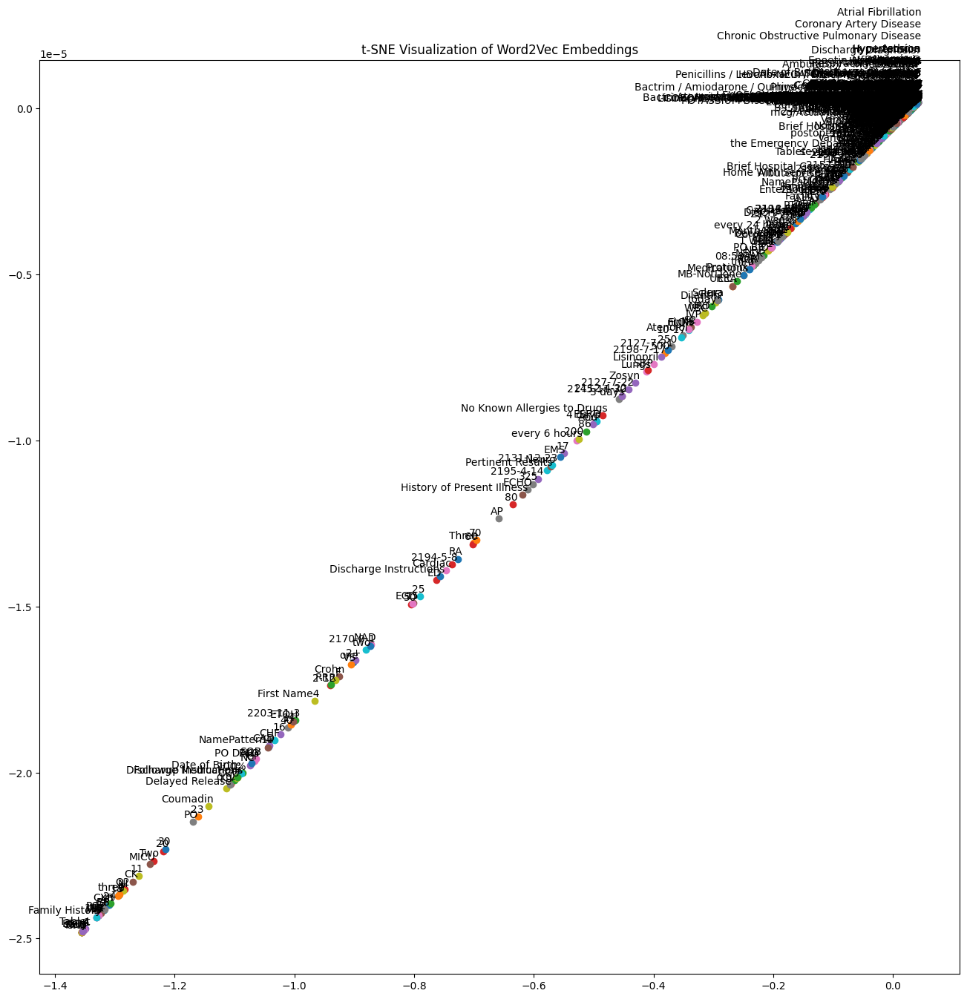

In [13]:
# Define a function to create a t-SNE plot
def tsne_plot(model, words, preTrained=False):
    labels = []
    tokens = []

    for word in words:
        try:
            if preTrained:
                tokens.append(model[word])
            else:
                tokens.append(model.wv[word])
            labels.append(word)
        except KeyError:
            print("Skipping '{}' (not in vocabulary)".format(word))

    tokens = np.array(tokens)
    tsne_model = TSNE(perplexity=30, early_exaggeration=12, n_components=2,
                      init='pca', n_iter=250, random_state=23)
    new_values = tsne_model.fit_transform(tokens)

    x = new_values[:, 0]
    y = new_values[:, 1]

    plt.figure(figsize=(16, 16))
    for i, label in enumerate(labels):
        plt.scatter(x[i], y[i])
        plt.annotate(label,
                     xy=(x[i], y[i]),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')
    plt.title("t-SNE Visualization of Word2Vec Embeddings")
    plt.show()
# Plot t-SNE for the Word2Vec
vocab_words = list(w2v_model.wv.key_to_index.keys())
tsne_plot(w2v_model, vocab_words)

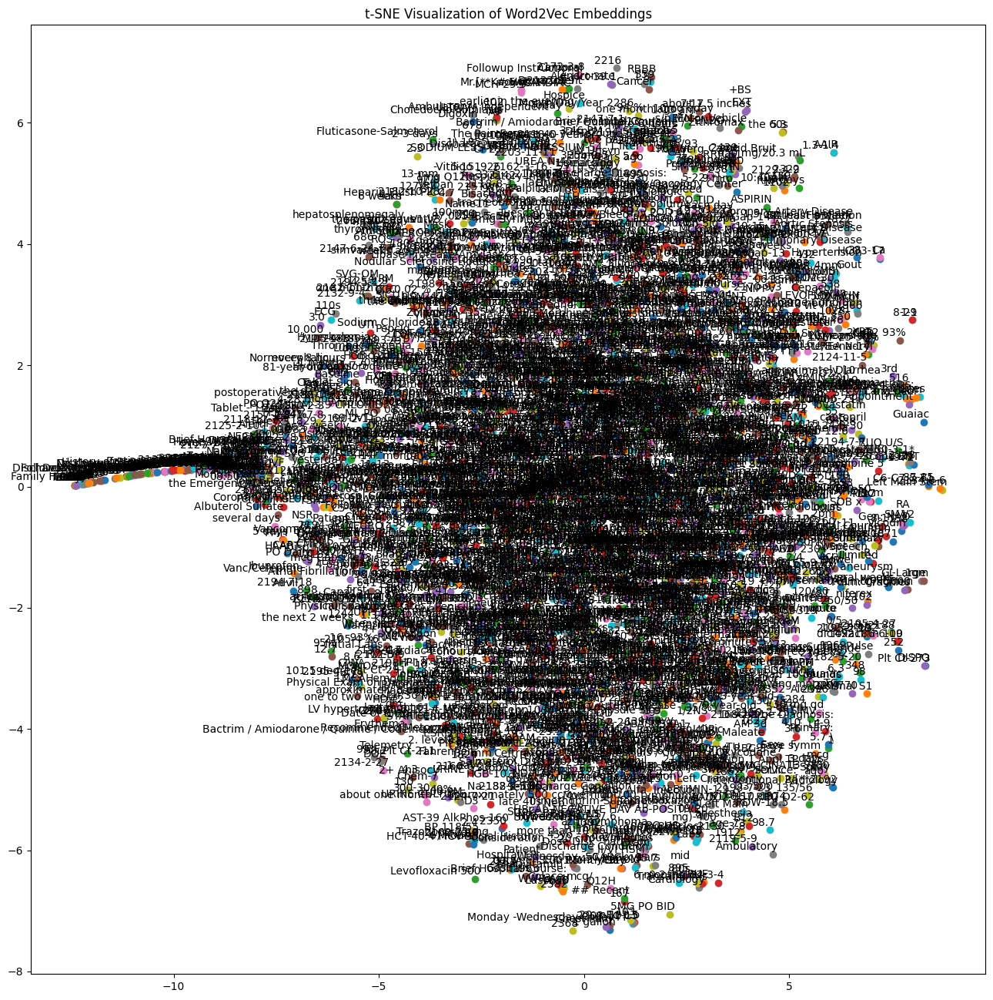

In [16]:
# Define a function to create a t-SNE plot
def tsne_plot(model, words, preTrained=False):
    labels = []
    tokens = []

    for word in words:
        try:
            if preTrained:
                tokens.append(model[word])
            else:
                tokens.append(model.wv[word])
            labels.append(word)
        except KeyError:
            print("Skipping '{}' (not in vocabulary)".format(word))

    tokens = np.array(tokens)
    tsne_model = TSNE(perplexity=30, early_exaggeration=12, n_components=2,
                      init='pca', n_iter=400, random_state=23)
    new_values = tsne_model.fit_transform(tokens)

    x = new_values[:, 0]
    y = new_values[:, 1]

    plt.figure(figsize=(16, 16))
    for i, label in enumerate(labels):
        plt.scatter(x[i], y[i])
        plt.annotate(label,
                     xy=(x[i], y[i]),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')
    plt.title("t-SNE Visualization of Word2Vec Embeddings")
    plt.show()
# Plot t-SNE for the Word2Vec
vocab_words = list(w2v_model.wv.key_to_index.keys())
tsne_plot(w2v_model, vocab_words)

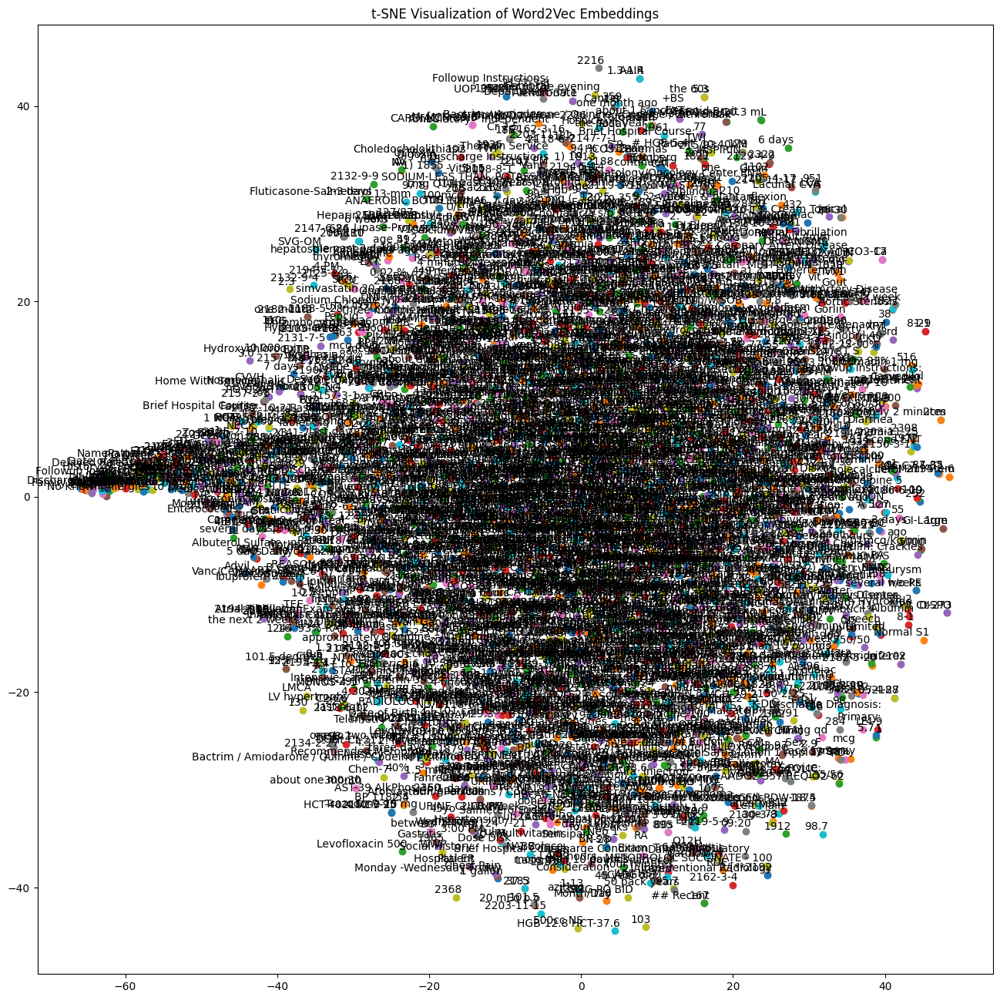

In [17]:
# Define a function to create a t-SNE plot
def tsne_plot(model, words, preTrained=False):
    labels = []
    tokens = []

    for word in words:
        try:
            if preTrained:
                tokens.append(model[word])
            else:
                tokens.append(model.wv[word])
            labels.append(word)
        except KeyError:
            print("Skipping '{}' (not in vocabulary)".format(word))

    tokens = np.array(tokens)
    tsne_model = TSNE(perplexity=30, early_exaggeration=12, n_components=2,
                      init='pca', n_iter=1000, random_state=23)
    new_values = tsne_model.fit_transform(tokens)

    x = new_values[:, 0]
    y = new_values[:, 1]

    plt.figure(figsize=(16, 16))
    for i, label in enumerate(labels):
        plt.scatter(x[i], y[i])
        plt.annotate(label,
                     xy=(x[i], y[i]),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')
    plt.title("t-SNE Visualization of Word2Vec Embeddings")
    plt.show()
# Plot t-SNE for the Word2Vec
vocab_words = list(w2v_model.wv.key_to_index.keys())
tsne_plot(w2v_model, vocab_words)

In [14]:
!pip install transformers

In [15]:
# Load Tokenizers for Different Biomedical Models
bert_tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
clinical_tokenizer = AutoTokenizer.from_pretrained("emilyalsentzer/Bio_ClinicalBERT")
blue_tokenizer = AutoTokenizer.from_pretrained('bionlp/bluebert_pubmed_mimic_uncased_L-12_H-768_A-12')
biobert_tokenizer = AutoTokenizer.from_pretrained('dmis-lab/biobert-base-cased-v1.2')
scibert_tokenizer = AutoTokenizer.from_pretrained('allenai/scibert_scivocab_uncased')

In [16]:
# Load Pre-trained Models
models = {
    "BERT": {
        "model": AutoModel.from_pretrained("bert-base-uncased"),
        "tokenizer": bert_tokenizer,
    },
    "ClinicalBERT": {
        "model": AutoModel.from_pretrained("emilyalsentzer/Bio_ClinicalBERT"),
        "tokenizer": clinical_tokenizer,
    },
    "BlueBERT": {
        "model": AutoModel.from_pretrained("bionlp/bluebert_pubmed_mimic_uncased_L-12_H-768_A-12"),
        "tokenizer": blue_tokenizer,
    },
    "BioBERT": {
        "model": AutoModel.from_pretrained("dmis-lab/biobert-base-cased-v1.2"),
        "tokenizer": biobert_tokenizer,
    },
    "SciBERT": {
        "model": AutoModel.from_pretrained("allenai/scibert_scivocab_uncased"),
        "tokenizer": scibert_tokenizer,
    },
}




In [2]:
# Extract hypertension note from NOTEEVENTS

def extract_unique_notes(input_file, keyword, output_file):
    with gzip.open(input_file, 'rt', encoding='utf-8') as f:
        df = pd.read_csv(f, usecols=['TEXT'])


    df['TEXT'] = df['TEXT'].astype(str).str.lower()
    filtered_notes = df[df['TEXT'].str.contains(keyword, na=False)]

    unique_notes = filtered_notes['TEXT'].drop_duplicates().tolist()

    # Save to text file
    with open(output_file, 'w', encoding='utf-8') as f:
        for note in unique_notes:
            f.write(note + "\n\n")

    print(f"Extracted {len(unique_notes)} unique notes related to '{keyword}'.")

extract_unique_notes("NOTEEVENTS.csv.gz", "hypertension", "hypertension.txt")



Extracted 114470 unique notes related to 'hypertension'.


In [8]:
# Load Medical Notes
notes = []
with open('hypertension.txt', 'r') as fin:
    lines = fin.readlines()
    for line in lines:
        notes.append(line)
print("Total Notes Loaded:", len(notes))



Total Notes Loaded: 18670798


In [7]:
# Tokenization Comparison Across Models
for i, text in enumerate(notes[:1]):
    bert_tokens = bert_tokenizer.tokenize(text)
    clinical_tokens = clinical_tokenizer.tokenize(text)
    bluebert_tokens = blue_tokenizer.tokenize(text)
    biobert_tokens = biobert_tokenizer.tokenize(text)

    # Ensure equal length padding for correct display
    while len(clinical_tokens) < len(bert_tokens):
        clinical_tokens.append("")
    while len(bluebert_tokens) < len(bert_tokens):
        bluebert_tokens.append("")
    while len(biobert_tokens) < len(bert_tokens):
        biobert_tokens.append("")

    # Display Tokens
    print('{:<15} {:<15} {:<15} {:<15}'.format("BERT", "ClinicalBERT", "BlueBERT", "BioBERT"))
    print('{:<15} {:<15} {:<15} {:<15}'.format("----", "-----------", "--------", "-------"))
    for tup in zip(bert_tokens, clinical_tokens, bluebert_tokens, biobert_tokens):
        print('{:<15} {:<15} {:<15} {:<15}'.format(tup[0], tup[1], tup[2], tup[3]))





BERT            ClinicalBERT    BlueBERT        BioBERT        
----            -----------     --------        -------        
admission       admission       admission       admission      
date            date            date            date           
:               :               :               :              
[               [               [               [              
*               *               *               *              
*               *               *               *              
211             211             211             211            
##8             ##8             ##8             ##8            
-               -               -               -              
6               6               6               6              
-               -               -               -              
2               2               2               2              
*               *               *               *              
*               *               *       

In [2]:
# Load models and tokenizers
model_dict = {
    "BERT": "bert-base-uncased",
    "BlueBERT": "bionlp/bluebert_pubmed_mimic_uncased_L-12_H-768_A-12",
    "ClinicalBERT": "emilyalsentzer/Bio_ClinicalBERT"
}

models = {}
tokenizers = {}

for model_name, model_path in model_dict.items():
    tokenizers[model_name] = AutoTokenizer.from_pretrained(model_path)
    models[model_name] = AutoModel.from_pretrained(model_path)
    models[model_name].eval()

In [3]:
# Total Notes Loaded: 18670798
# Read only the first 500 lines of the medical notes
with open("hypertension.txt", "r") as file:
    lines = [next(file) for _ in range(500)]


text = "".join(lines)

print("Total Lines Loaded:", len(lines))

Total Lines Loaded: 500


In [3]:
#  Read the medical notes
# with open("hypertension.txt", "r") as file:
#   text = file.read()

In [4]:
# Clean and tokenize text
def clean_text(text):
    words = text.split()
    clean_words = [word.lower() for word in words if word.isalnum()]
    return " ".join(clean_words)

cleaned_text = clean_text(text)
input_tokens = cleaned_text.split()

In [5]:
# Function to extract word embeddings
def get_embedding(model, tokenizer, word):
    inputs = tokenizer(word, return_tensors="pt")
    with torch.no_grad():
        outputs = model(**inputs)
    token_emb = outputs.last_hidden_state.mean(dim=1).squeeze().numpy()
    return token_emb

In [6]:
# Extract embeddings for all words
embeddings_dict = {model: {} for model in models}

for model_name, model in models.items():
    tokenizer = tokenizers[model_name]
    word_embs = []

    for token in input_tokens:
        if token not in string.punctuation:
            try:
                token_emb = get_embedding(model, tokenizer, token)
                word_embs.append(token_emb)
            except:
                continue

    if word_embs:
        embeddings_dict[model_name] = np.array(word_embs)

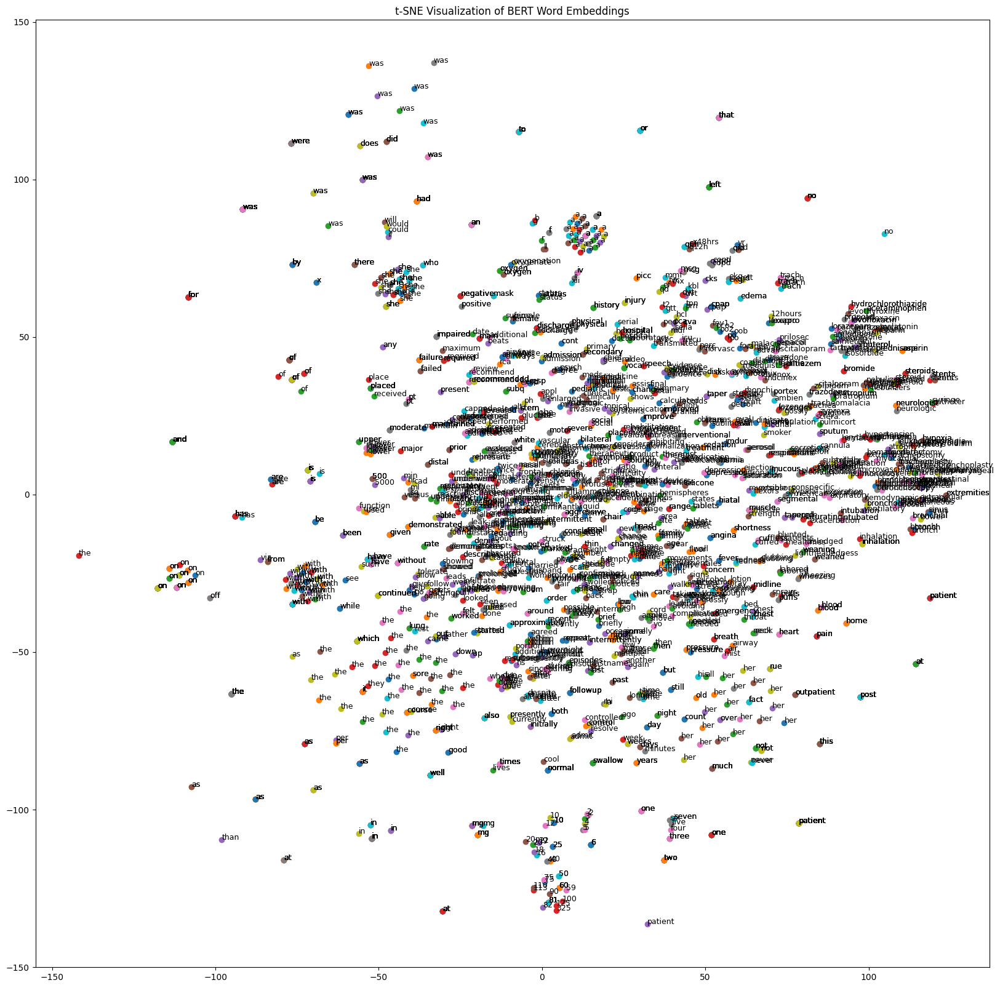

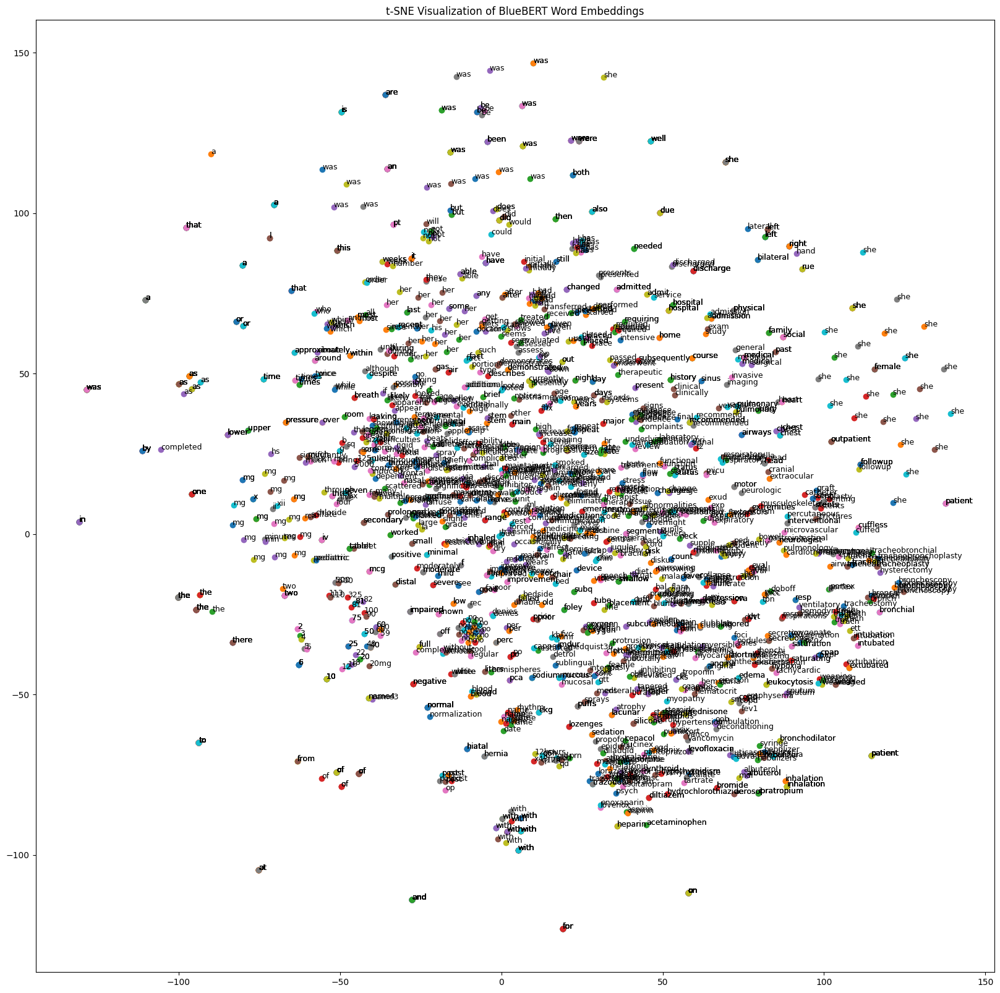

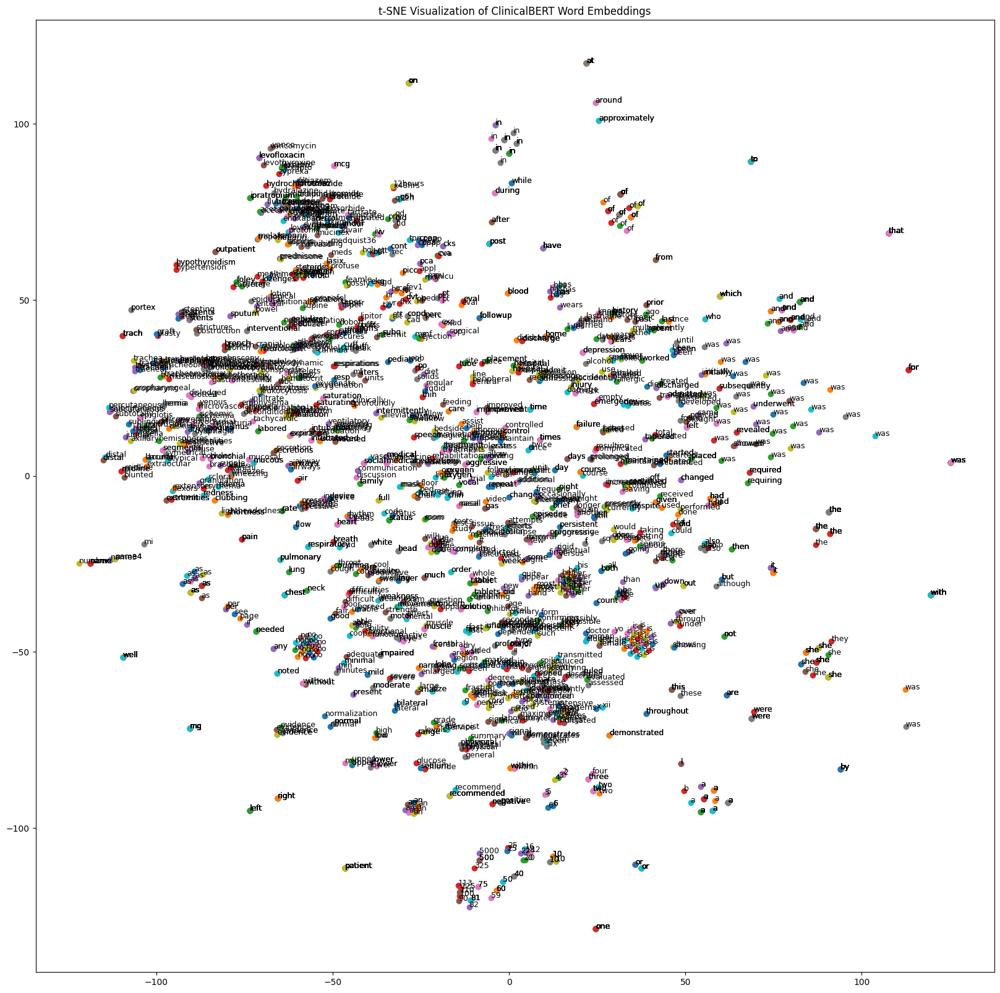

In [7]:
# t-SNE plot for each model
def tsne_plot_per_model(embeddings_dict):
    for model_name, word_embeddings in embeddings_dict.items():
        if len(word_embeddings) == 0:
            print(f"Skipping {model_name} due to no embeddings.")
            continue

        # Apply t-SNE
        tsne_model = TSNE(n_components=2, perplexity=10, random_state=42)
        transformed_embs = tsne_model.fit_transform(word_embeddings)

        # Plot t-SNE results
        plt.figure(figsize=(20, 20))
        for i in range(len(transformed_embs)):
            plt.scatter(transformed_embs[i, 0], transformed_embs[i, 1])
            plt.annotate(input_tokens[i], (transformed_embs[i, 0], transformed_embs[i, 1]), fontsize=9)

        plt.title(f"t-SNE Visualization of {model_name} Word Embeddings")
        plt.show()


tsne_plot_per_model(embeddings_dict)